In [3]:
!ls /kaggle/input/processed-gan/processed_GAN

00021101800-e1.jpg   03268312707-e1.jpg		06224316251-e1.jpg
00039678807-e1.jpg   03268312800-e1.jpg		06224323250-e1.jpg
00039680802-e1.jpg   03268314707-e1.jpg		06224323710-e1.jpg
00039786803-e1.jpg   03268314800-e1.jpg		06224330620-e1.jpg
00039788800-e1.jpg   03284356505-e1.jpg		06224331898-e1.jpg
00039788803-e1.jpg   03284356712-e1.jpg		06224332460-e1.jpg
00048303712-e1.jpg   03284356732-e1.jpg		06224333727-e1.jpg
00071700401-e1.jpg   03284356800-e1.jpg		06224334620-e1.jpg
00071700800-e1.jpg   03332303428-e1.jpg		06224335712-e1.jpg
00077304401-e1.jpg   03332303514-e1.jpg		06224666407-e1.jpg
00077304700-e1.jpg   03332303712-e1.jpg		06224889251-e1.jpg
00077304710-e1.jpg   03332310401-e1.jpg		06224894802-e1.jpg
00077304800-e1.jpg   03332310700-e1.jpg		06399300700-e1.jpg
00077305401-e1.jpg   03332310712-e1.jpg		06416300251-e1.jpg
00077305800-e1.jpg   03332310803-e1.jpg		06416300800-e1.jpg
00088676684-e1.jpg   03332320401-e1.jpg		06427100715-e1.jpg
00102830800-e1.jpg   03332320610-e1.jpg	

The model was trained in a fast-track way, meaning on a small dataset with limited resources and time. I collected a dataset of 1,648 images of flattened clothing from the Internet. In total, we had 1,600 training images. The task was to train the model to generate images of clothing in a flattened form and then, using inversion and a target image of a person wearing the clothing, make the model generate the flattened clothing.

We did not separate shoes and clothing, although it would have been more correct to train two models. However, our model does not make mistakes and does not confuse shoes with clothing. Of course, this affected the accuracy of generation.

# Some additional installations and downloads

In [1]:
!pip install Ninja
!pip install torch torchvision torchaudio
!pip install numpy matplotlib tqdm

In [2]:
import torch
import torchvision
import torchaudio
import numpy as np
import random

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"✅ CUDA available: {device}")

seed = 42
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)

✅ CUDA available: cuda


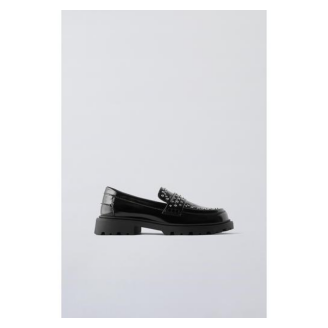

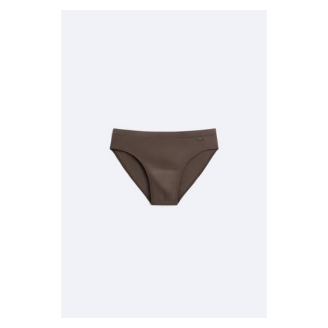

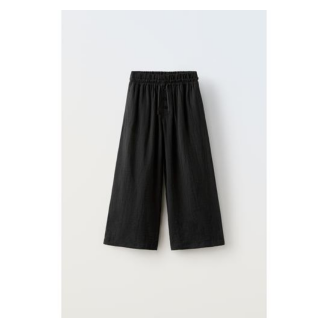

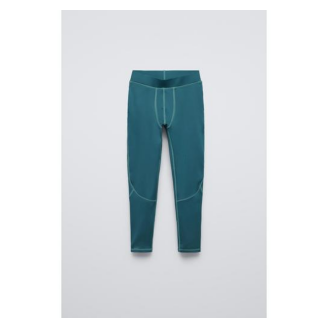

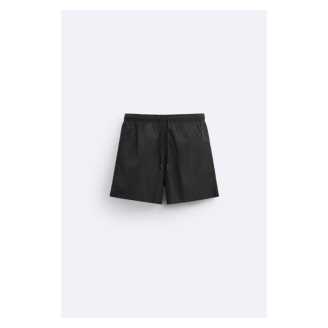

In [4]:
import os
import shutil
import subprocess
from PIL import Image
import glob
from tqdm import tqdm
import matplotlib.pyplot as plt

# We choose random 5 images
def show_images(folder, num_images=5):
    images = glob.glob(os.path.join(folder, "*.jpg")) + glob.glob(os.path.join(folder, "*.png"))
    selected_images = random.sample(images, min(num_images, len(images)))

    for img_path in selected_images:
        img = Image.open(img_path)
        plt.figure(figsize=(4, 4))
        plt.imshow(img)
        plt.axis("off")
        plt.show()
        

show_images("/kaggle/input/processed-gan/processed_GAN")

In [6]:
import torch.optim as optim
import torch.nn as nn
from torchvision.utils import save_image
from torchvision import transforms  
from torch.nn import functional as F

In [7]:
!rm -rf stylegan3
!git clone https://github.com/NVlabs/stylegan3.git

Cloning into 'stylegan3'...
remote: Enumerating objects: 212, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 212 (delta 0), reused 0 (delta 0), pack-reused 208 (from 2)
Receiving objects: 100% (212/212), 4.17 MiB | 21.69 MiB/s, done.
Resolving deltas: 100% (98/98), done.


In [11]:
# Conversion to TPRecords for training StyleGAN3
!python3 stylegan3/dataset_tool.py \
    --source=/kaggle/input/processed-gan/processed_GAN \
    --dest=/kaggle/working/processed_gan_tfrecord



100%|███████████████████████████████████████| 1648/1648 [00:24<00:00, 67.81it/s]


In [15]:
# Downloading a pre-trained FFHQ model for Transfer Learning (stylegan3-r)
!wget -c https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/stylegan3-r-afhqv2-512x512.pkl -O stylegan3-afhq.pkl

--2025-01-26 15:37:17--  https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/stylegan3-r-afhqv2-512x512.pkl
Resolving api.ngc.nvidia.com (api.ngc.nvidia.com)... 44.227.231.63, 54.68.27.61
Connecting to api.ngc.nvidia.com (api.ngc.nvidia.com)|44.227.231.63|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://xfiles.ngc.nvidia.com/org/nvidia/team/research/models/stylegan3/versions/1/files/stylegan3-r-afhqv2-512x512.pkl?versionId=v35qSSnL0.NfuZxxvZsKFFBRqfGIMdee&Expires=1737992237&Signature=OOK1Yuoim9fhw4e2qFhAR9w8m5l67xApfPm6ZZ5XImNhajqNR32ZE1knWWpdK05yXjVo9Au8wRC7Lb~RJYzaUT7QMsDEAkweHi4z0BWvkD-QVak8l5i0DTlu5yX6Bix07-ZhhKUTArupjKoMQRAuoOrYUlY~kruLOS-IJ2qJDjTJI1F6FJVdeJEgBCk-o67NBJnbN567FkOsKhy-YoJhqHhy3CFIn8visKAT1PkJloJ4FETXfSxcQgtcAhvj20AeWr~7eSh1nSRTJkCV2rlpPfjachrXoMEF3LhtnDsml90PBLWqOHwuVMt~kwcXHesnx9O8TZuOEx-oN82wQ0pD7A__&Key-Pair-Id=KCX06E8E9L60W [following]
--2025-01-26 15:37:17--  https://xfiles.ngc.nvidia.com/org/nvi

# Training StyleGAN3 on Flattened Clothing Dataset
This step launches the training process of StyleGAN3-R on a dataset of flattened clothing images using Kaggle's GPU resources. The dataset is preprocessed into TFRecord format to optimize performance.

We start training with the following key parameters:

Pretrained Model: The training resumes from stylegan3-afhq.pkl, a model initially trained on the AFHQ dataset.
Dataset: Located at /kaggle/working/processed_gan_tfrecord, containing flattened clothing images.
GPU Usage: The training runs on 1 GPU, which is the limit on Kaggle.
Batch Size: Set to 4 due to GPU memory constraints.
Gamma Regularization: Set to 10, ensuring balanced gradient penalty.
Snapshots (snap=2): Intermediate images are saved every 2k iterations to monitor progress.
Training Duration (kimg=10): The model trains on 10,000 images, which is a short run to test settings before full-scale training.
💡 Goal:
Train a generative model capable of producing realistic flattened clothing images, which will later be used for inversion tasks.

In [ ]:
!python3 stylegan3/train.py \
    --outdir=./training-runs \
    --cfg=stylegan3-r \
    --data=/kaggle/working/processed_gan_tfrecord \
    --gpus=1 \
    --batch=4 \
    --gamma=10 \
    --snap=2 \
    --kimg=10 \
    --resume=stylegan3-afhq.pkl



Training options:
{
  "G_kwargs": {
    "class_name": "training.networks_stylegan3.Generator",
    "z_dim": 512,
    "w_dim": 512,
    "mapping_kwargs": {
      "num_layers": 2
    },
    "channel_base": 65536,
    "channel_max": 1024,
    "magnitude_ema_beta": 0.9998613801725043,
    "conv_kernel": 1,
    "use_radial_filters": true
  },
  "D_kwargs": {
    "class_name": "training.networks_stylegan2.Discriminator",
    "block_kwargs": {
      "freeze_layers": 0
    },
    "mapping_kwargs": {},
    "epilogue_kwargs": {
      "mbstd_group_size": 4
    },
    "channel_base": 32768,
    "channel_max": 512
  },
  "G_opt_kwargs": {
    "class_name": "torch.optim.Adam",
    "betas": [
      0,
      0.99
    ],
    "eps": 1e-08,
    "lr": 0.0025
  },
  "D_opt_kwargs": {
    "class_name": "torch.optim.Adam",
    "betas": [
      0,
      0.99
    ],
    "eps": 1e-08,
    "lr": 0.002
  },
  "loss_kwargs": {
    "class_name": "training.loss.StyleGAN2Loss",
    "r1_gamma": 10.0,
    "blur_init_s

Training StyleGAN3: From Kaggle to AWS

Initially, we attempted to train the model in Kaggle, but the process was halted due to limited computational resources. As a result, the full training was conducted on AWS, utilizing:

4 GPUs for parallel processing Batch size of 16 500k images processed (kimg=500) With these settings and continuous evolution, the training took approximately 20 hours. The best-performing model, evaluated based on its metric score of 31, was saved as: network-snapshot-000432.pkl

This model will be used for further processing and inversion tasks.

🔹 Optimization Potential Training time could be significantly reduced by adjusting the evaluation frequency, optimizing resource usage without compromising quality.

🔹 Output Image Resolution The model was trained to generate 1024×1024 resolution images, ensuring high-quality outputs.

## To begin with, we will carry out some auxiliary work and load all the necessary materials.

In [4]:
import torch
import torchvision
import torchaudio
import numpy as np
import random
import glob
import matplotlib.pyplot as plt
from google.colab import drive
import torch.optim as optim
from torchvision.utils import save_image
from PIL import Image
import math  
import os 
from torch.nn import functional as F
from torchvision import transforms  
from tqdm import tqdm

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"✅ CUDA available: {device}")

✅ CUDA available: cuda


In [5]:
import sys
sys.path.append("/kaggle/working/stylegan3")  


In [6]:
from training.networks_stylegan3 import Generator

In [7]:
!pip install lpips

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 2.9 MB/s eta 0:00:00


In [ ]:

## We  work with a specific seed
 torch.manual_seed(42)

In [ ]:
import shutil

!mkdir -p /kaggle/working/model_weights/

from IPython.display import FileLink
FileLink("/kaggle/input/model432/network-snapshot-000432.pkl")

/kaggle/working/model_weights/network-snapshot-000432.pkl

In [10]:
import dnnlib
import pickle
from torch_utils import misc

In [25]:
import os
os.environ['TORCH_CUDA_ARCH_LIST'] = "8.6" 


In [11]:
os.environ["TORCH_CUDA_ARCH_LIST"] = "7.5"  

In [12]:
!nvidia-smi


Thu Jan 30 08:08:37 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 560.35.03              Driver Version: 560.35.03      CUDA Version: 12.6     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   35C    P8             10W /   70W |       3MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [13]:
network_pkl = "/kaggle/input/model432/network-snapshot-000432.pkl"

with open(network_pkl, "rb") as f:
    G = pickle.load(f)["G_ema"].cuda()  

print("✅ Model loaded successfully!")

✅ Model loaded successfully!


# Image generated from Gaussian noise

In [90]:
# Random latent vector
z = torch.randn([1, G.z_dim]).cuda()

# We generate an image
img = G(z, None)

In [91]:
output_path = "/kaggle/working/generated_image2.png"
save_image(img, output_path)


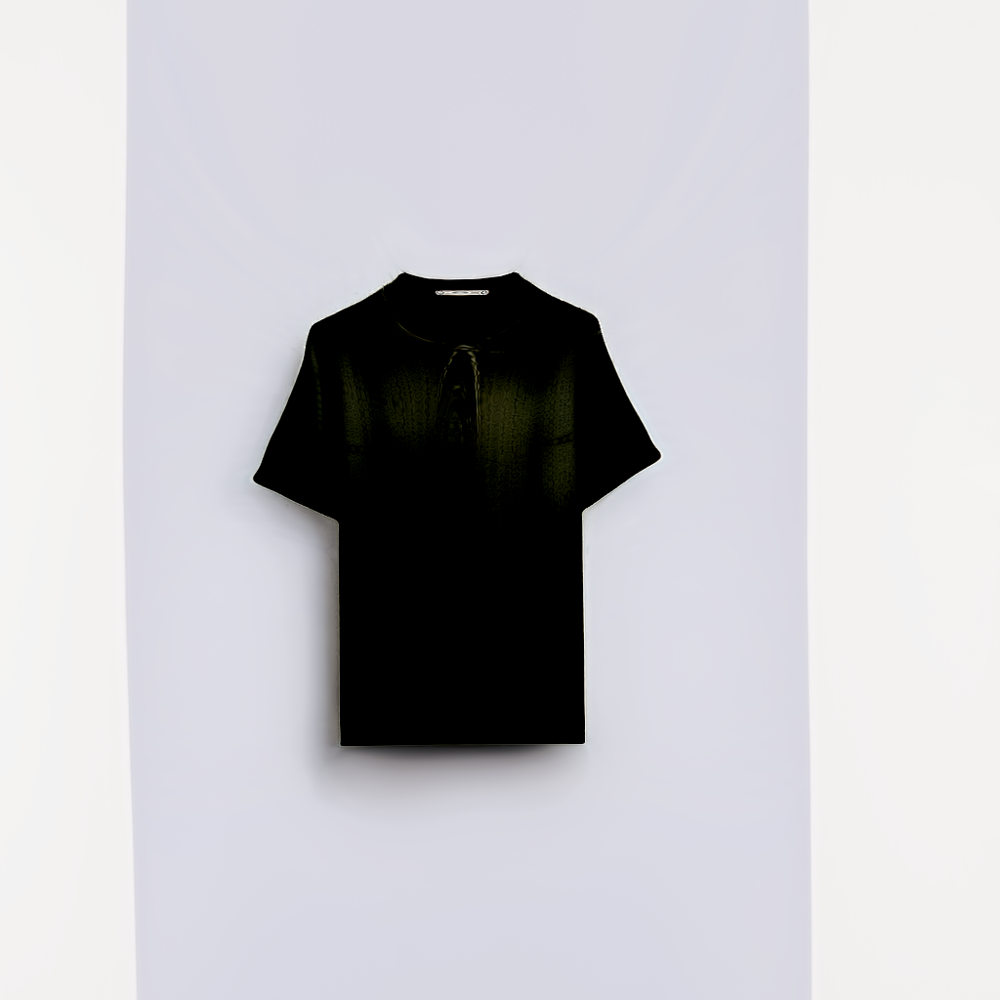

In [92]:
# We display the image
image = Image.open(output_path)
display(image)

In [78]:
# Random latent vector
z = torch.randn([1, G.z_dim]).cuda()

# We generate an image
img = G(z, None)

In [79]:
output_path = "/kaggle/working/generated_image1.png"
save_image(img, output_path)


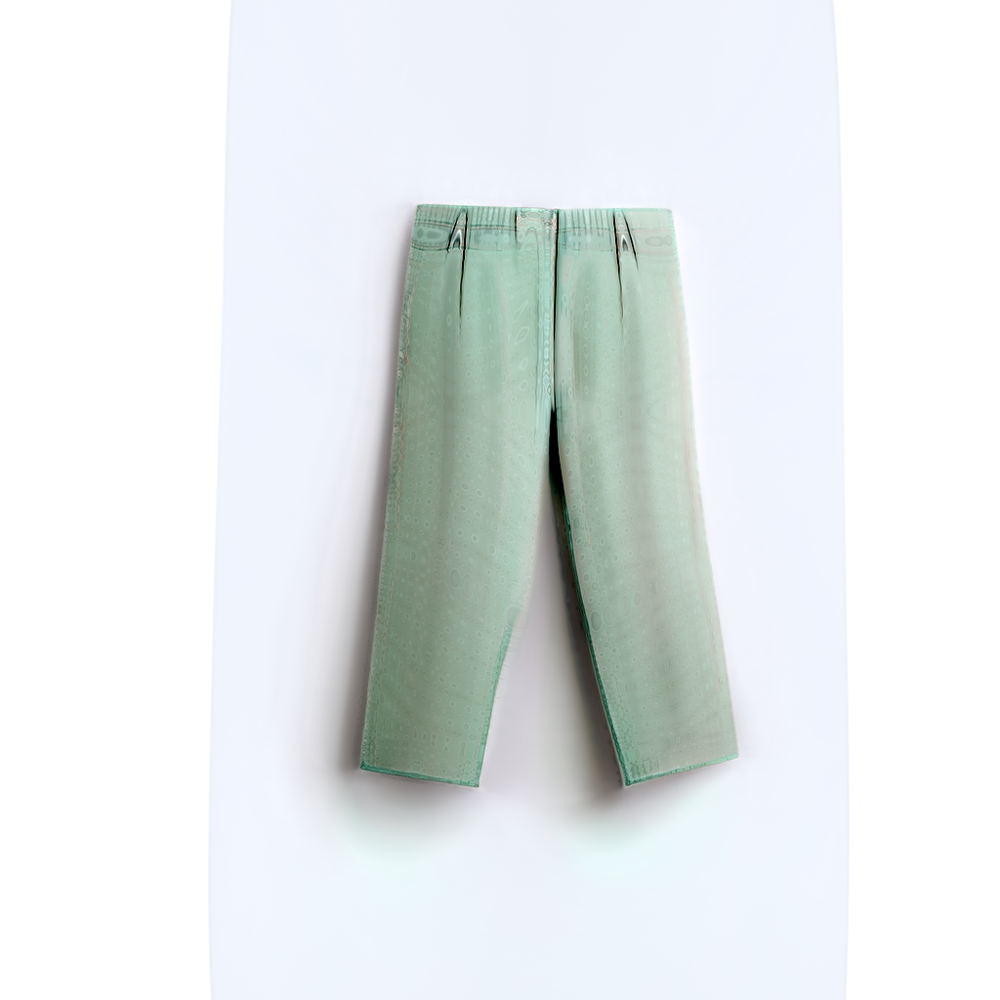

In [80]:
# We display the image
image = Image.open(output_path)
display(image)

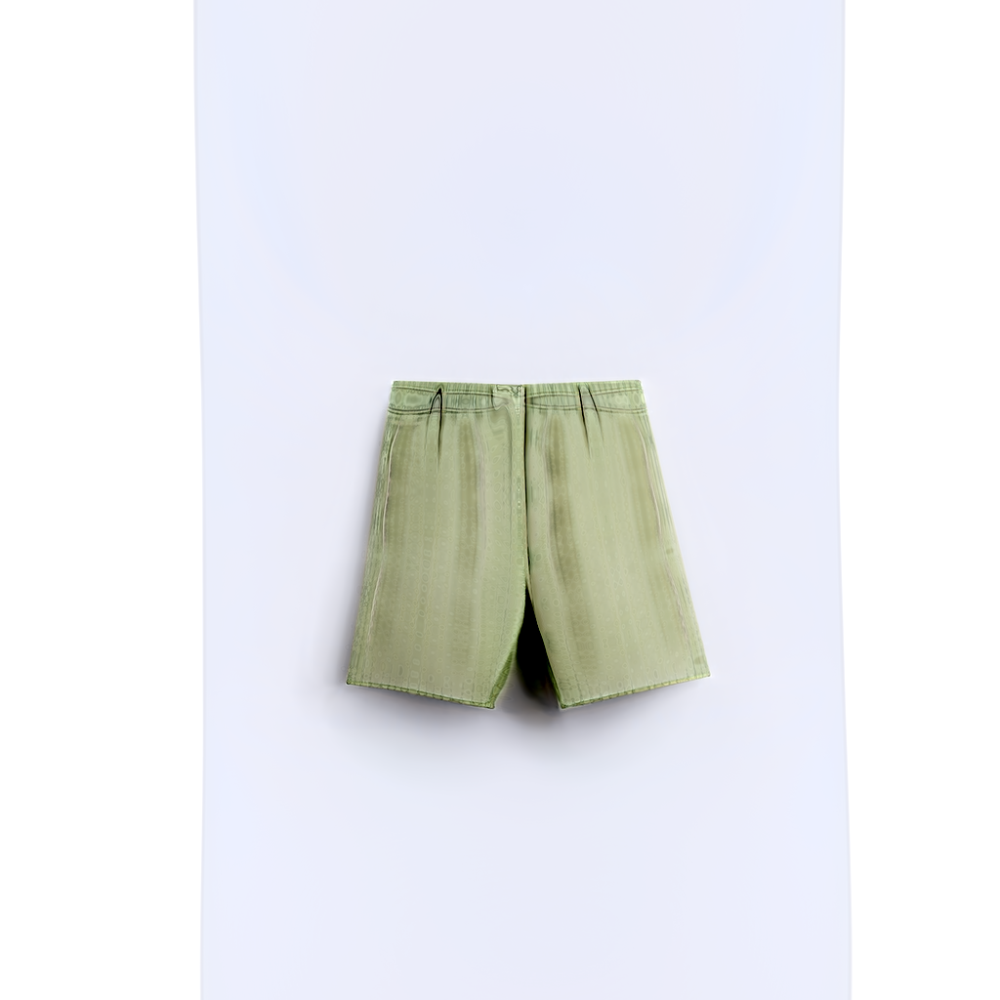

In [23]:
z = torch.randn([1, G.z_dim]).cuda()

# We generate an image
img = G(z, None)
output_path = "/kaggle/working/generated_image3.png"
save_image(img, output_path)
# We display the image
image = Image.open(output_path)
display(image)

In [24]:
%matplotlib inline

In [25]:
!pip install lpips

In [26]:
import lpips



In [27]:
loss_fn = lpips.LPIPS(net='vgg').cuda()

# LPIPS
def load_image(image_path):
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor()
    ])
    image = Image.open(image_path).convert("RGB")
    return transform(image).unsqueeze(0).cuda()

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 212MB/s] 


Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


/usr/local/lib/python3.10/dist-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_path, map_location='cpu'), st

In [28]:

print(os.listdir("/kaggle/input/samples"))  


['image0.jpeg', '5.jpg', '1.jpg', '4.jpg', 'image1.jpeg', '3.jpg', '2.jpg']


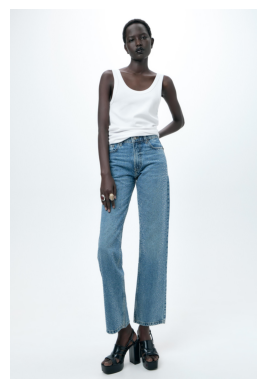

In [45]:
from PIL import Image
import matplotlib.pyplot as plt

image_path = "/kaggle/input/samples/5.jpg"

image1 = Image.open(image_path)

plt.imshow(image1)
plt.axis("off") 
plt.show()


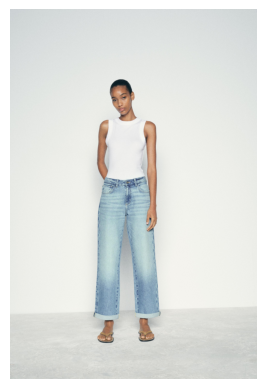

In [47]:
image_path = "/kaggle/input/samples/1.jpg"

image2 = Image.open(image_path)

plt.imshow(image2)
plt.axis("off") 
plt.show()

In [48]:
image1 = Image.open("/kaggle/input/samples/5.jpg").convert("RGB")
image2 = Image.open("/kaggle/input/samples/1.jpg").convert("RGB") 
# Transformation: image → tensor
transform = transforms.Compose([
    transforms.Resize((256, 256)),  
    transforms.ToTensor(),          
    transforms.Normalize([0.5], [0.5])  
])

image1_tensor = transform(image1).unsqueeze(0).cuda()  
image2_tensor = transform(image2).unsqueeze(0).cuda()

# Calculation of LPIPS-similarity
distance = loss_fn(image1_tensor, image2_tensor)

print(f"LPIPS Similarity Score: {distance.item():.4f}")

LPIPS Similarity Score: 0.3730


# ==============================================================
# StyleGAN3 – Advanced Image Generation Model
# ==============================================================
# StyleGAN3 is a powerful Generative Adversarial Network (GAN) 
# that allows the creation of highly realistic and diverse images 
# with fine details and smooth transitions.

# 🔹 The key improvement over previous architectures (see Fig. (a) - StyleGAN2) 
# is the removal of aliasing artifacts, which were present in StyleGAN2 
# due to improper convolutional operations. StyleGAN3 introduces 
# continuous signal representation, eliminating these distortions.

# ==============================================================
# Architecture of StyleGAN3
# ==============================================================
# Like previous versions, StyleGAN3 consists of two networks:

# 1️⃣ Mapping Network:
#    - Converts a random latent vector 𝑧 into a more structured 𝑤 vector, 
#      also known as the style space.
#    - This transformation allows better control over generated features.
#    - Transformation: 𝑧(1×512) → 𝑤(1×512)

# 2️⃣ Synthesis Network:
#    - The core part of the model responsible for image generation.
#    - Major improvements over StyleGAN2:
#      ✅ Uses continuous signal representation instead of discrete pixel-based features.
#      ✅ Eliminates aliasing artifacts through filtered convolutions instead of traditional upsampling.
#      ✅ Generates more stable images where objects do not shift or distort when interpolating in the latent space.

# ==============================================================
# Key Improvements in StyleGAN3
# ==============================================================
# ✅ Alias-Free Generation → No "grid-based" artifacts, resulting in smoother, more natural images.
# ✅ Consistent Object Structures → Objects remain stable when interpolating between latent vectors.
# ✅ More Precise Editing → Latent space edits have a more predictable effect on the image.

# ==============================================================
# Comparison: StyleGAN2 vs. StyleGAN3
# ==============================================================

# | Feature              | StyleGAN2                      | StyleGAN3                      |
# |----------------------|--------------------------------|--------------------------------|
# | Latent Space        | 𝑤 (512)                        | 𝑤 (512)                        |
# | Upsampling         | Traditional Convolutions + AdaIN | Filtered Convolutions          |
# | Alias-Free Generation | ❌ No                          | ✅ Yes                          |
# | Stability of Objects | Objects "float"               | Objects remain stable          |
# | Training Time      | Faster                          | Slower due to complex operations |
# | Image Quality     | High but with artifacts        | Higher with smooth transitions |

# ==============================================================
# Architecture of StyleGAN3 (Visual Representation)
# ==============================================================
# 📌 Figure: Comparison of Traditional GANs, StyleGAN2, and StyleGAN3 (Source: NVIDIA)

# ==============================================================
# Conclusion
# ==============================================================
# 💡 StyleGAN3 is a major leap in generative modeling, removing aliasing distortions 
# and creating more natural, stable images.

# For further details, refer to the official NVIDIA paper on StyleGAN3.


# Inversion in Z space

The real image is loaded and prepared.


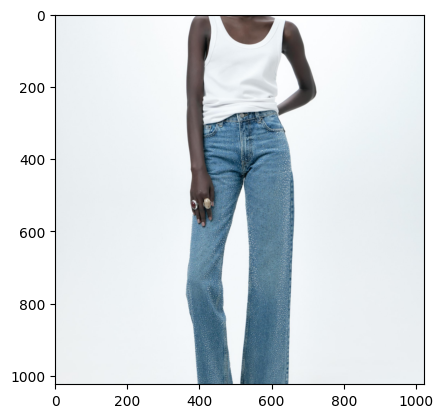

In [29]:
real_image_path = '/kaggle/input/samples/5.jpg'

target_img = Image.open(real_image_path).convert('RGB')


transform = transforms.Compose([
    transforms.CenterCrop(min(target_img.size)),
    transforms.Resize((1024, 1024))
])


target_img = transform(target_img)

target_img_tensor = torch.tensor(np.array(target_img).transpose(2, 0, 1)).float().to(device) / 255.
target_img_tensor = target_img_tensor.unsqueeze(0)* 2 - 1 #Adding batch dimensions and [0, 1] -> [-1, 1]

print("The real image is loaded and prepared.")

plt.imshow((target_img_tensor.cpu()[0].permute(1, 2, 0) + 1)/2)

plt.show()

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth
Step [0/600], Loss: 0.7477


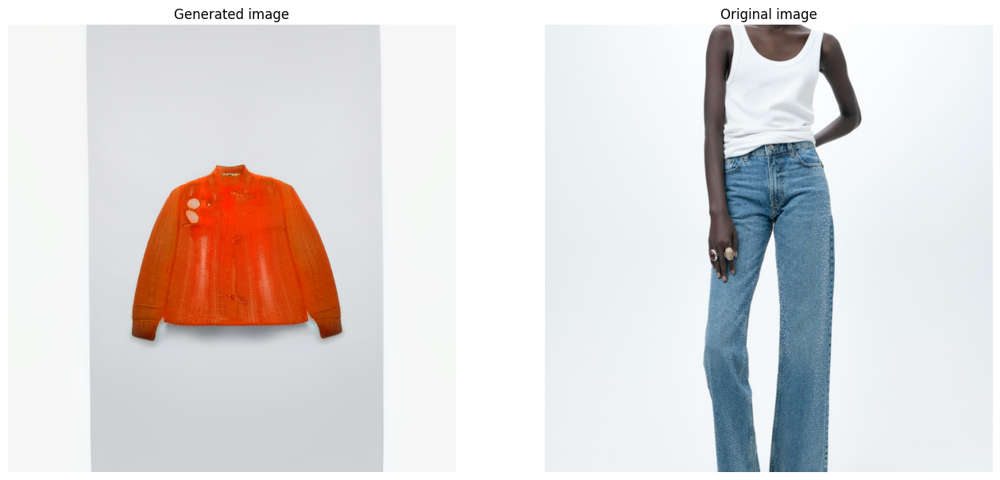

Step [100/600], Loss: 0.4857


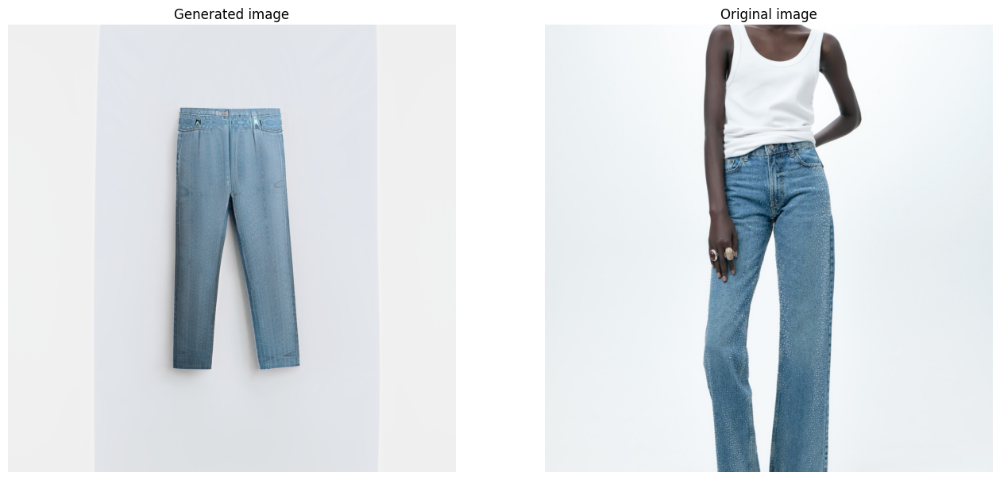

Step [200/600], Loss: 0.4750


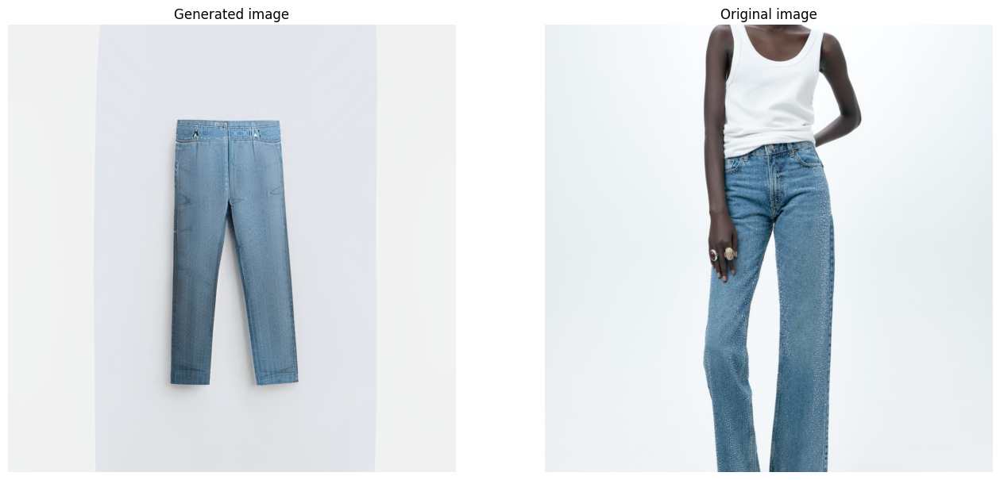

Step [300/600], Loss: 0.4713


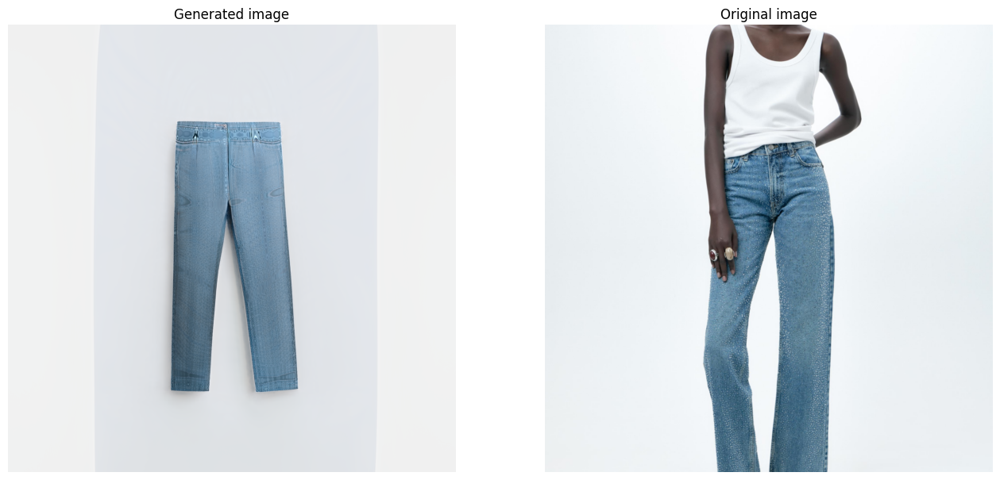

Step [400/600], Loss: 0.4695


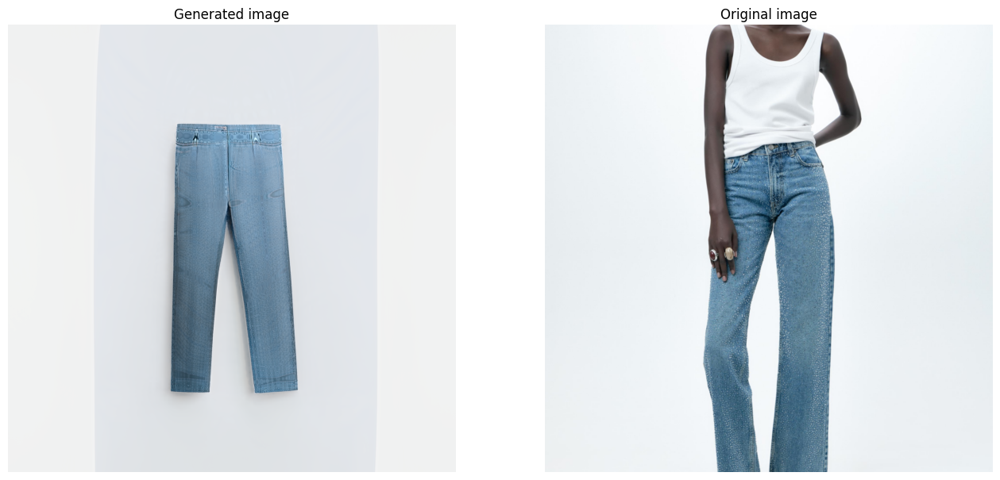

Step [500/600], Loss: 0.4688


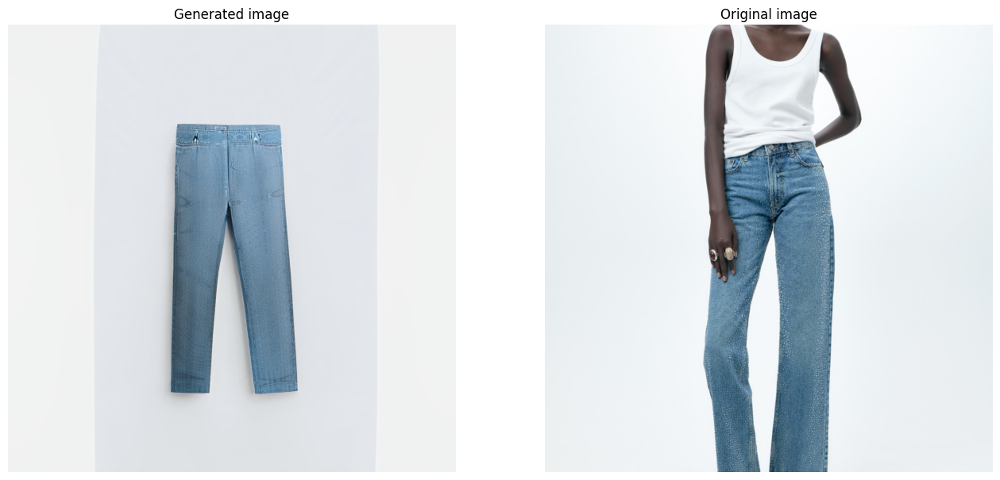

✅ The inversion in Z-space is complete.


In [76]:
latent_z = torch.randn((1, G.z_dim), device=device, requires_grad=True)  
optimizer_z = optim.Adam([latent_z], lr=0.1)  
scheduler_z = torch.optim.lr_scheduler.ExponentialLR(optimizer_z, gamma=0.99)

mse_loss_fn = torch.nn.MSELoss()
lpips_loss_fn = lpips.LPIPS(net='vgg').to(device)  

num_steps = 600  
alpha = 1.0  # LPIPS
losses = {"mse": [], "lpips": [], "all": []}

for step in range(num_steps):
    torch.cuda.empty_cache()
    optimizer_z.zero_grad()  

    generated_img = G(latent_z, None)

    mse_loss = mse_loss_fn(generated_img, target_img_tensor)  # MSE Loss
    lpips_loss = lpips_loss_fn(generated_img, target_img_tensor).mean()  # LPIPS Loss
    loss = mse_loss + alpha * lpips_loss  

    loss.backward()
    optimizer_z.step()
    scheduler_z.step()

    losses['mse'].append(mse_loss.item())
    losses['lpips'].append(lpips_loss.item())
    losses['all'].append(loss.item())


    if step % 100 == 0:
        print(f"Step [{step}/{num_steps}], Loss: {loss.item():.4f}")  
        fig, axs = plt.subplots(1, 2, figsize=(16, 8))

        axs[0].imshow((generated_img.cpu().detach()[0].permute(1, 2, 0).clip(-1,1) + 1) / 2)
        axs[0].set_title("Generated image")
        axs[0].axis('off')

        axs[1].imshow((target_img_tensor.cpu().detach()[0].permute(1, 2, 0).clip(-1,1) + 1) / 2)
        axs[1].set_title("Original image")
        axs[1].axis('off')

        plt.show()

print("✅ The inversion in Z-space is complete.")

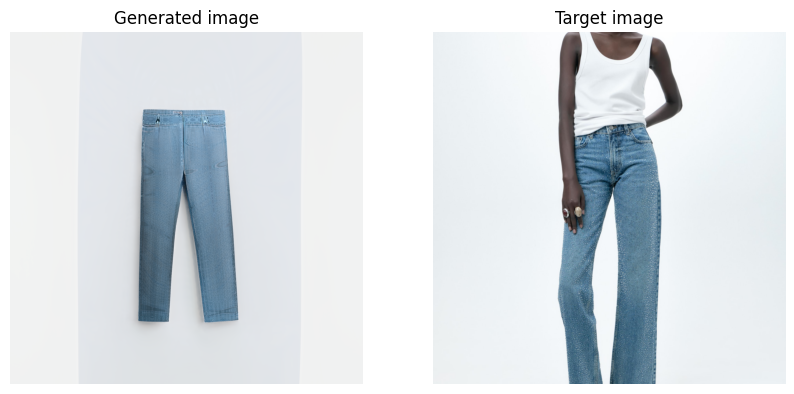

In [77]:
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow((generated_img.cpu().detach().squeeze().permute(1, 2, 0) + 1) / 2)
axs[0].set_title("Generated image")
axs[0].axis('off')

axs[1].imshow((target_img_tensor.cpu().squeeze().permute(1, 2, 0).clip(-1,1) + 1) / 2)
axs[1].set_title("Target image")
axs[1].axis('off')

plt.show()

# Let's change some parameters a little

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth
Step [0/700], Loss: 1.4140


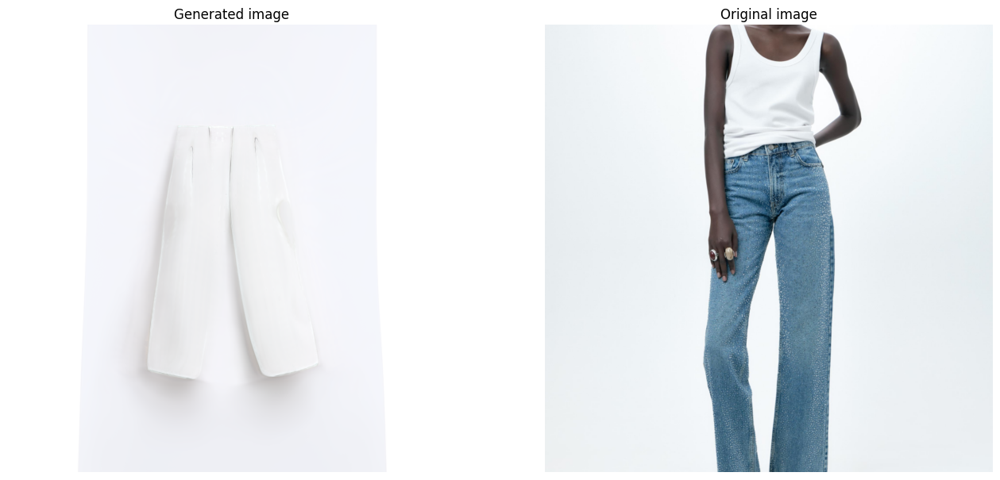

Step [100/700], Loss: 1.1657


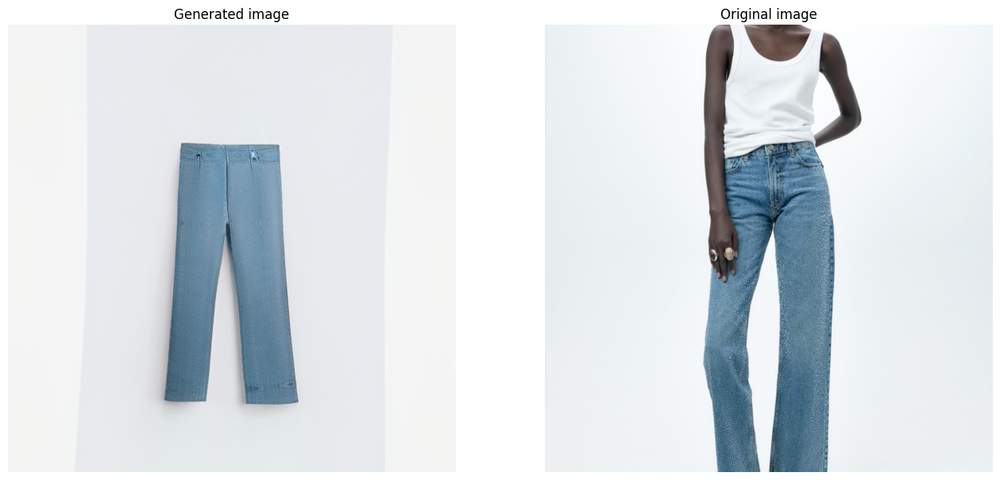

Step [200/700], Loss: 1.1375


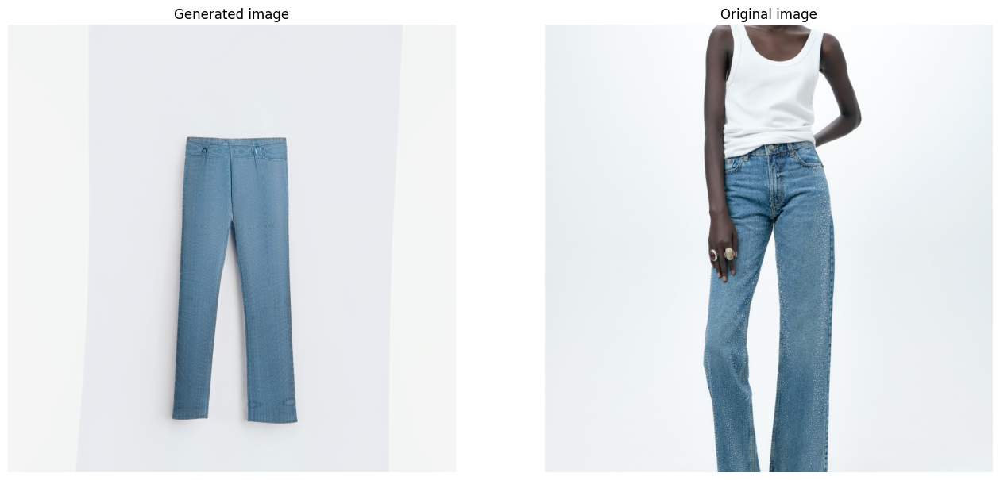

Step [300/700], Loss: 1.1267


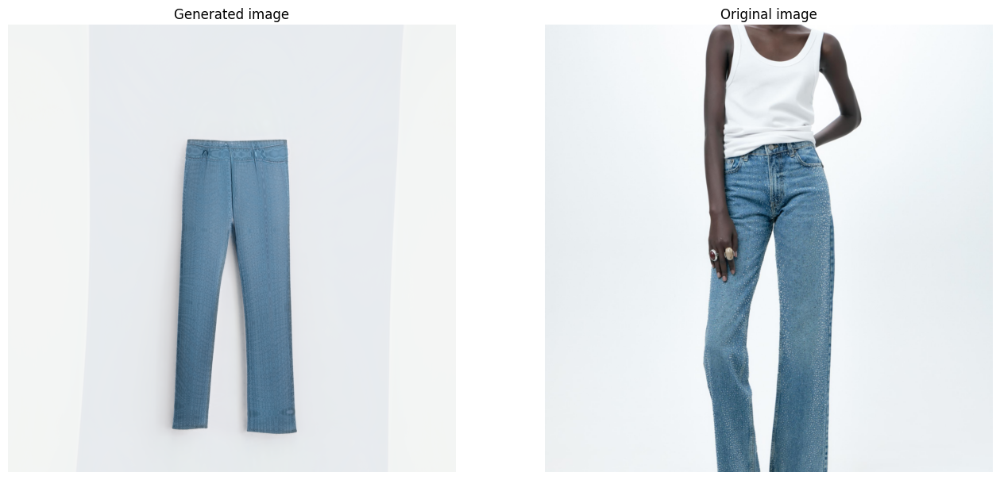

Step [400/700], Loss: 1.1222


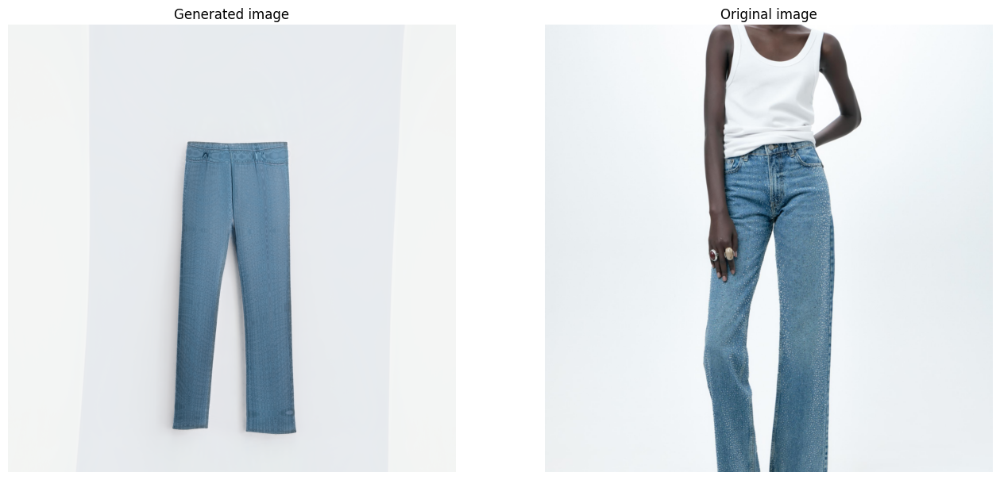

Step [500/700], Loss: 1.1207


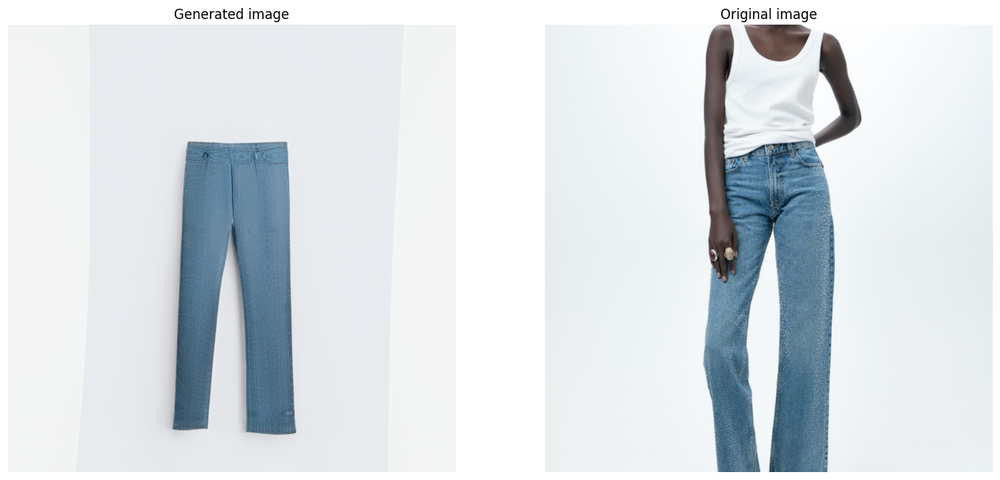

Step [600/700], Loss: 1.1204


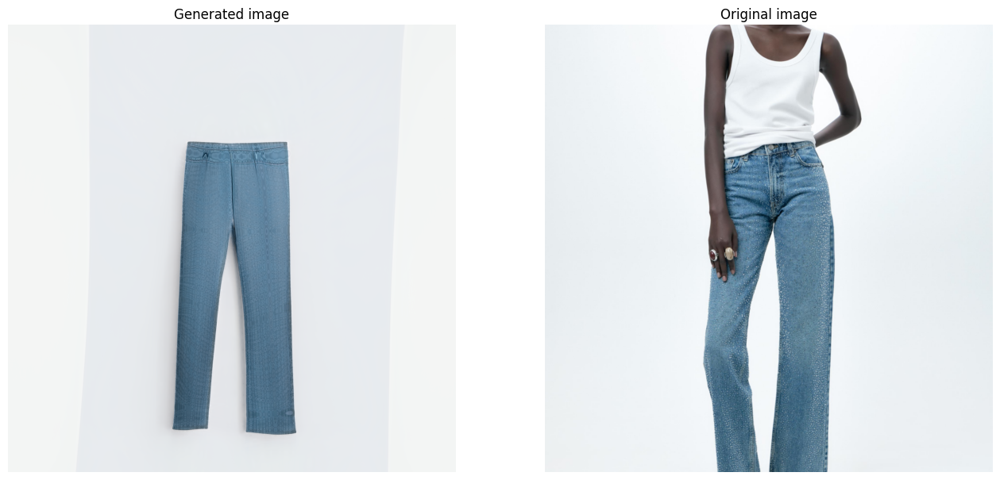

✅ The inversion in Z-space is complete.


In [36]:
latent_z = torch.randn((1, G.z_dim), device=device, requires_grad=True)  
optimizer_z = optim.Adam([latent_z], lr=0.1)  
scheduler_z = torch.optim.lr_scheduler.ExponentialLR(optimizer_z, gamma=0.99)

mse_loss_fn = torch.nn.MSELoss()
lpips_loss_fn = lpips.LPIPS(net='vgg').to(device)  

num_steps = 700  
alpha = 3.0  # LPIPS
losses = {"mse": [], "lpips": [], "all": []}

for step in range(num_steps):
    torch.cuda.empty_cache()
    optimizer_z.zero_grad()  

    generated_img = G(latent_z, None)

    mse_loss = mse_loss_fn(generated_img, target_img_tensor)  # MSE Loss
    lpips_loss = lpips_loss_fn(generated_img, target_img_tensor).mean()  # LPIPS Loss
    loss = mse_loss + alpha * lpips_loss  

    loss.backward()
    optimizer_z.step()
    scheduler_z.step()

    losses['mse'].append(mse_loss.item())
    losses['lpips'].append(lpips_loss.item())
    losses['all'].append(loss.item())


    if step % 100 == 0:
        print(f"Step [{step}/{num_steps}], Loss: {loss.item():.4f}")  
        fig, axs = plt.subplots(1, 2, figsize=(16, 8))

        axs[0].imshow((generated_img.cpu().detach()[0].permute(1, 2, 0).clip(-1,1) + 1) / 2)
        axs[0].set_title("Generated image")
        axs[0].axis('off')

        axs[1].imshow((target_img_tensor.cpu().detach()[0].permute(1, 2, 0).clip(-1,1) + 1) / 2)
        axs[1].set_title("Original image")
        axs[1].axis('off')

        plt.show()

print("✅ The inversion in Z-space is complete.")

# Inversion in space W+ or W

In [39]:

def get_lr(t, initial_lr, rampdown=0.25, rampup=0.05):
    lr_ramp = min(1, (1 - t) / rampdown)
    lr_ramp = 0.5 - 0.5 * math.cos(lr_ramp * math.pi)
    lr_ramp = lr_ramp * min(1, t / rampup)

    return initial_lr * lr_ramp

The real image is loaded and prepared.


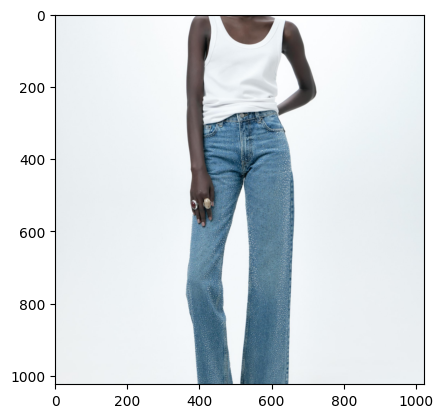

In [37]:
real_image_path = '/kaggle/input/samples/5.jpg'

target_img = Image.open(real_image_path).convert('RGB')

transform = transforms.Compose([
    transforms.CenterCrop(min(target_img.size)),
    transforms.Resize((1024, 1024))
])


target_img = transform(target_img)

target_img_tensor = torch.tensor(np.array(target_img).transpose(2, 0, 1)).float().to(device) / 255.
target_img_tensor = target_img_tensor.unsqueeze(0)* 2 - 1 

print("The real image is loaded and prepared.")

plt.imshow((target_img_tensor.cpu()[0].permute(1, 2, 0) + 1)/2)

plt.show()

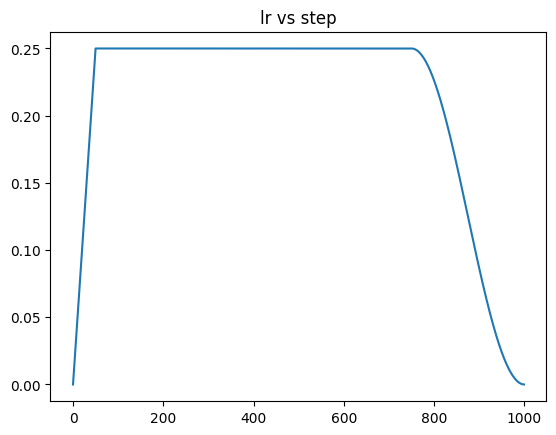

In [40]:
lr_steps = []
for step in range(1000):
    torch.cuda.empty_cache()
    t = step / 1000
    lr = get_lr(t, 0.25)
    lr_steps.append(lr)

plt.plot(lr_steps)
plt.title('lr vs step')
plt.show()

In [41]:
def noise_regularize(noises):
    """
    Noise regularization function.
    Calculates loss based on noise to reduce its influence on generation.

    Parameters:
    noises (list): List of noise tensors.

    Returns:
    loss (float): Total loss associated with noise.
    """
    loss = 0  

    for noise in noises: 
        size = noise.shape[2]

        while True: 
            loss = (
                loss
                + (noise * torch.roll(noise, shifts=1, dims=3)).mean().pow(2)  
                + (noise * torch.roll(noise, shifts=1, dims=2)).mean().pow(2)  
            )

            if size <= 8:
                break

            # Reducing the size of the noise by half
            noise = noise.reshape([-1, 1, size // 2, 2, size // 2, 2])
            noise = noise.mean([3, 5])
            size //= 2

    return loss


def noise_normalize_(noises):
    """
    Normalization of noise.
    Brings noise to zero mean and unit variance.

    Parameters:
    noises (list): List of noise tensors.
    """
    for noise in noises:
        mean = noise.mean()  
        std = noise.std()  
        noise.data.add_(-mean).div_(std)


def latent_noise(latent, strength):
    """
    Adding noise to the latent vector.
    Generates random noise and adds it to the latent vector.

    Parameters:
    latent (Tensor): Latent vector.
    strength (float): Strength of added noise.

    Returns:
    Tensor: Latent vector with added noise.
    """
    noise = torch.randn_like(latent) * strength

    return latent + noise

In [42]:
# Let's transform the optimized Z-vector into W-space
latent_z = torch.randn(10000, G.z_dim, device=device).mean(0, keepdim=True)  # Z noise
latent_w = G.mapping(latent_z, None)  
latent_mean = latent_w.mean(0)  
latent_std = ((latent_w - latent_mean).pow(2).sum() / 10000) ** 0.5  

print(latent_z.mean(0).shape, latent_mean.shape) 

torch.Size([512]) torch.Size([16, 512])


In [43]:
noises = [torch.randn(1, 1, 2**i, 2**i, device="cuda") for i in range(2, 10)]


In [ ]:
#With noise

Step [0/1000], Loss: 1.4746


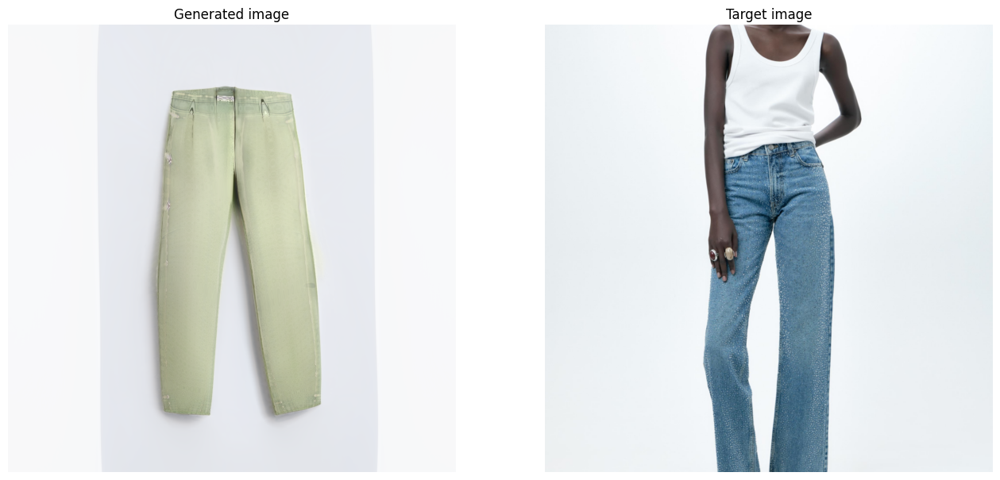

Step [50/1000], Loss: 0.9872


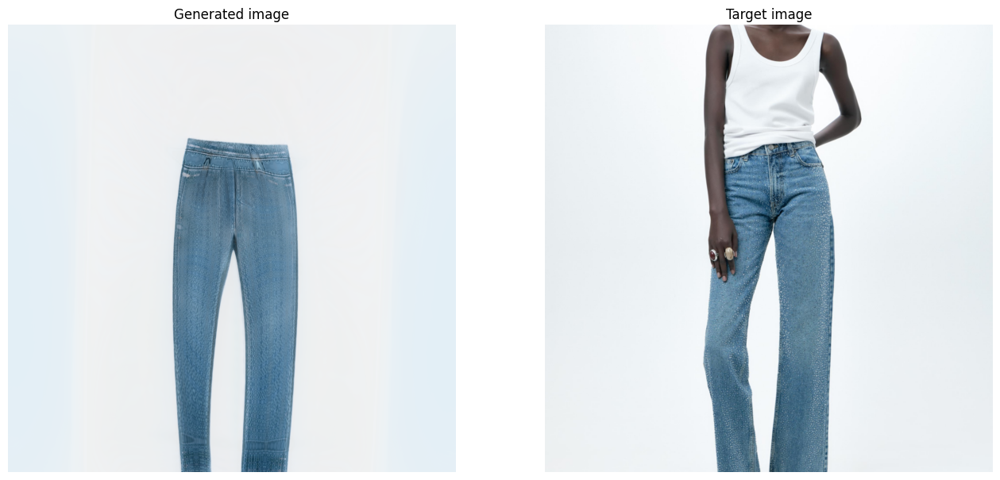

Step [100/1000], Loss: 0.9422


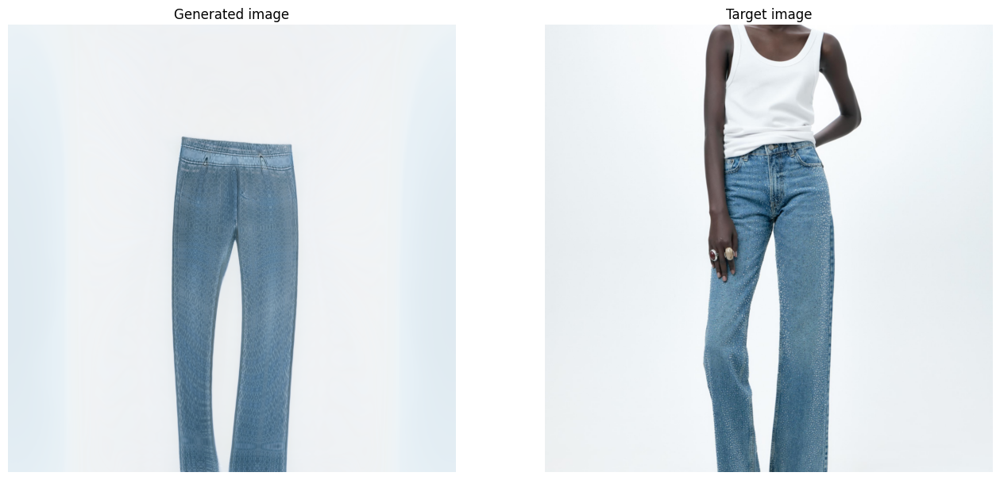

Step [150/1000], Loss: 0.9030


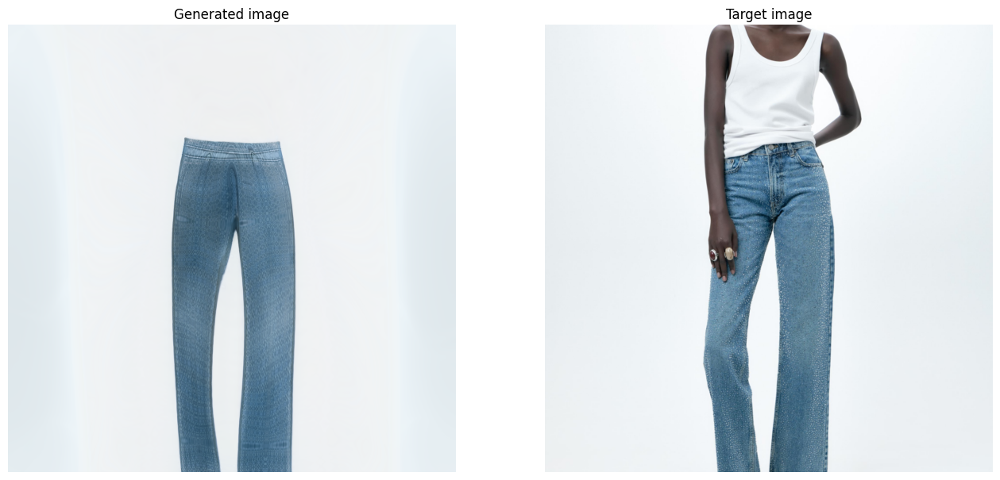

Step [200/1000], Loss: 0.8933


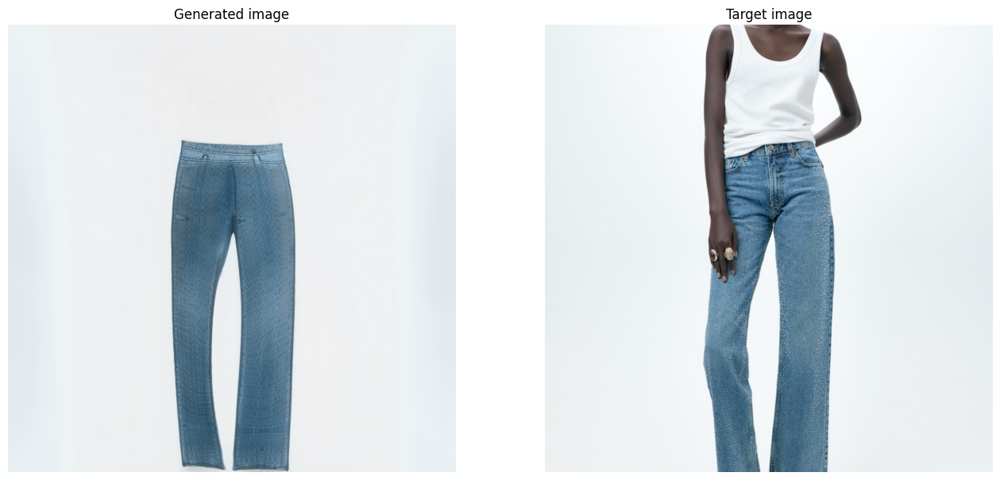

Step [250/1000], Loss: 0.8752


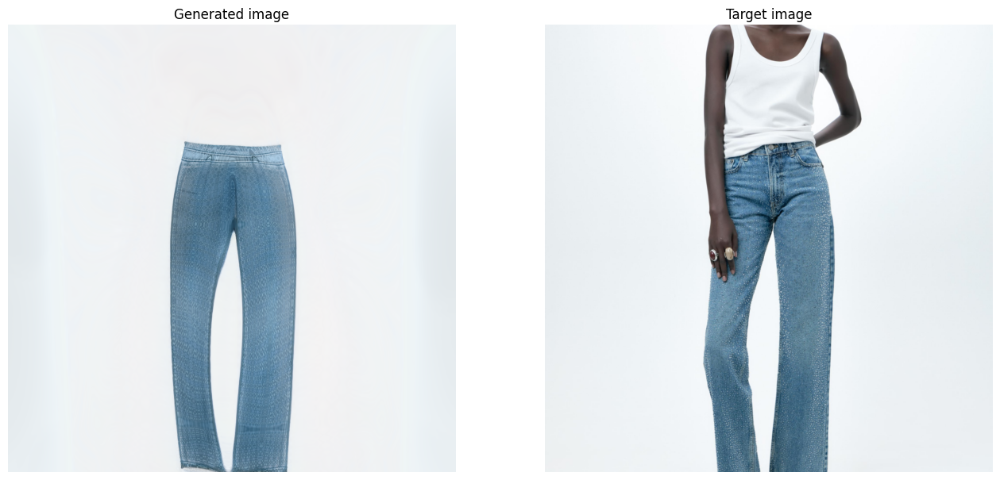

Step [300/1000], Loss: 0.9066


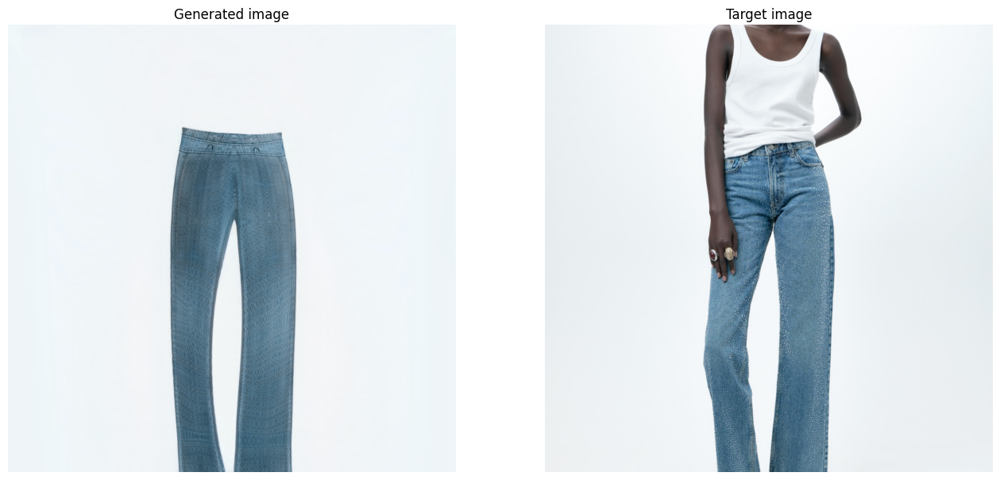

Step [350/1000], Loss: 0.8876


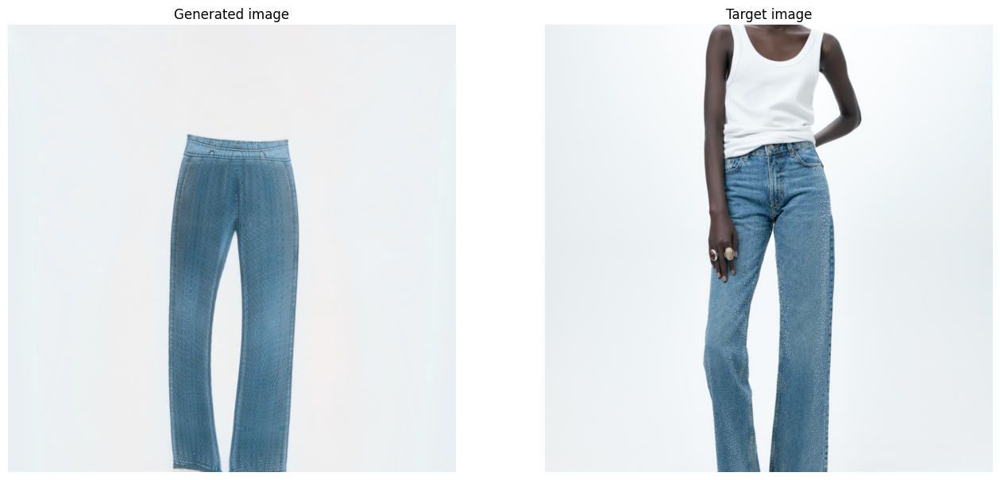

Step [400/1000], Loss: 0.8474


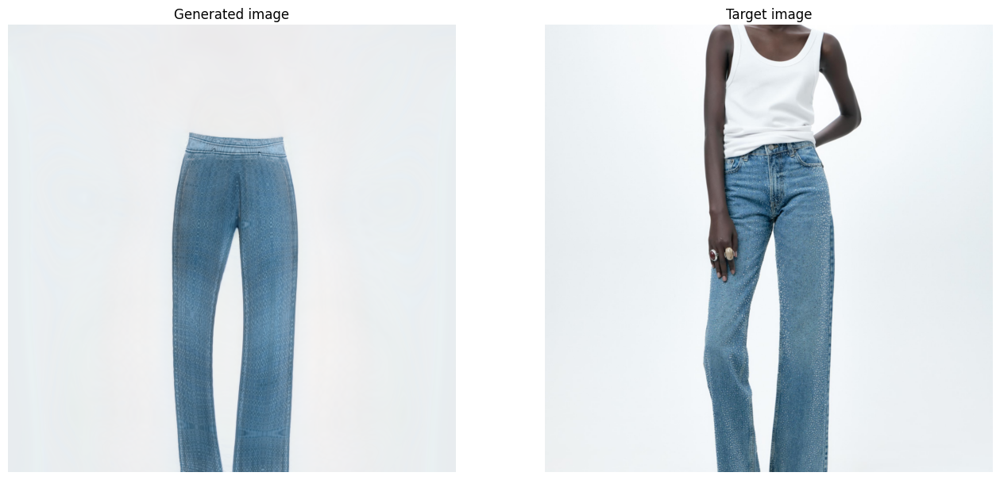

Step [450/1000], Loss: 0.8429


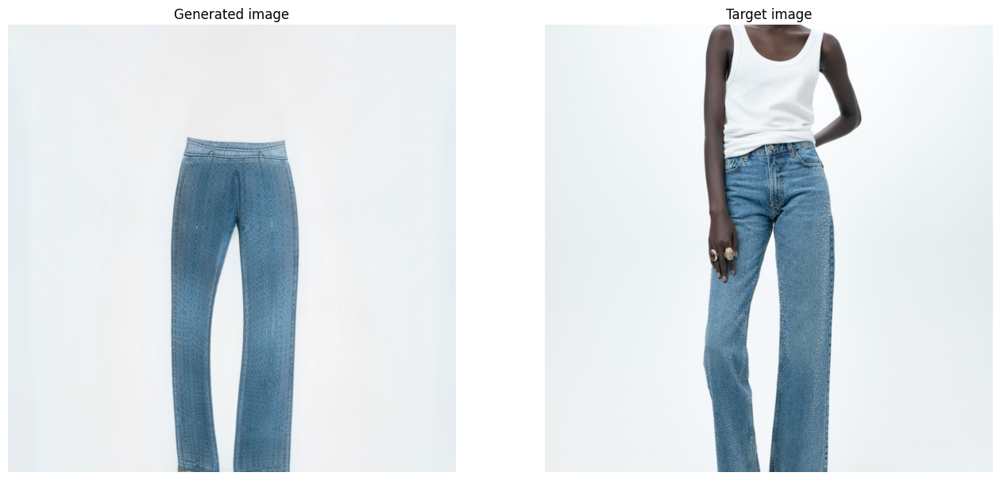

Step [500/1000], Loss: 0.8293


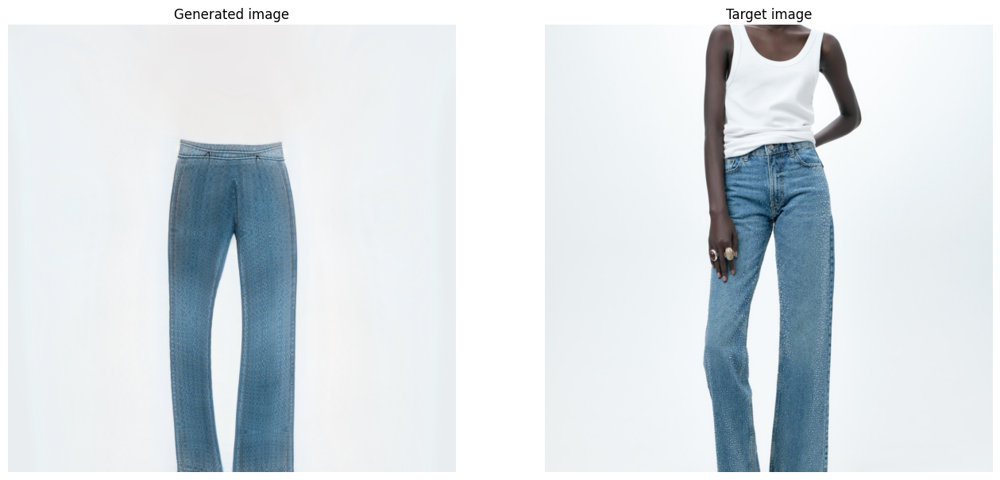

Step [550/1000], Loss: 0.8151


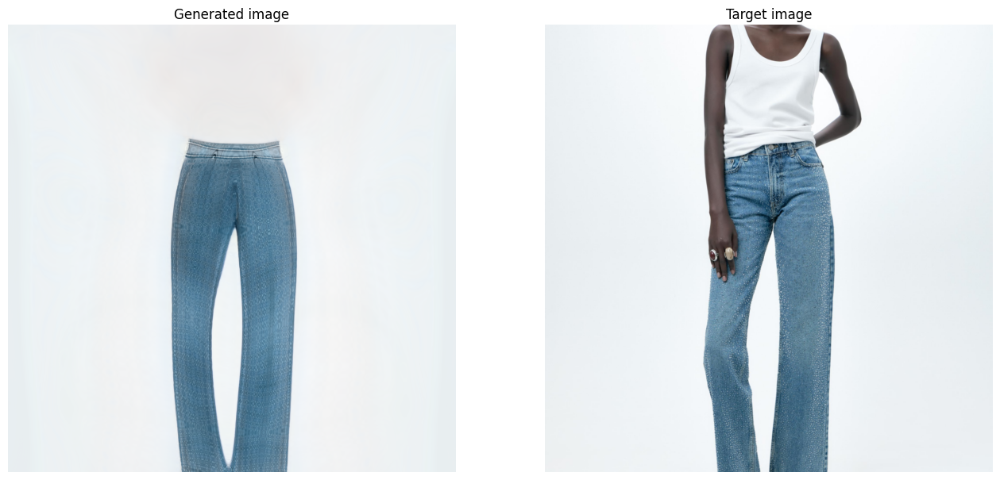

Step [600/1000], Loss: 0.8096


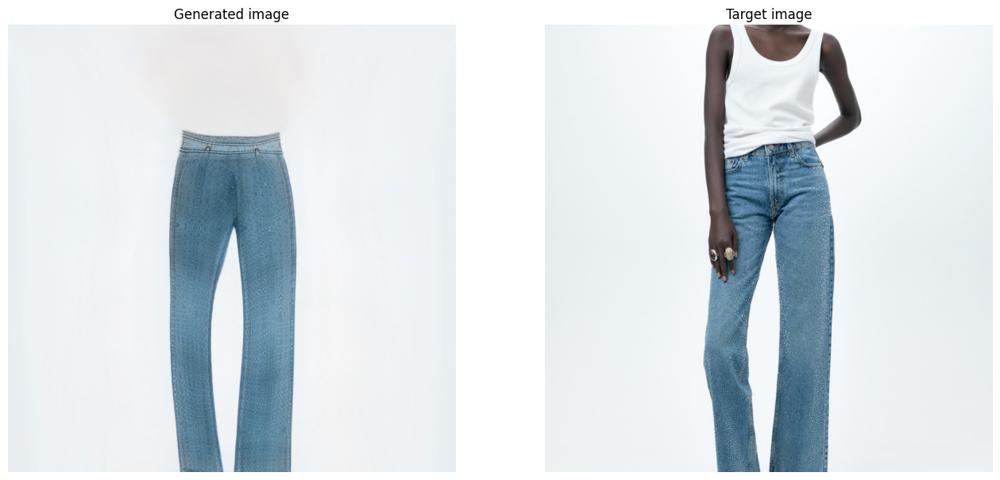

Step [650/1000], Loss: 0.7986


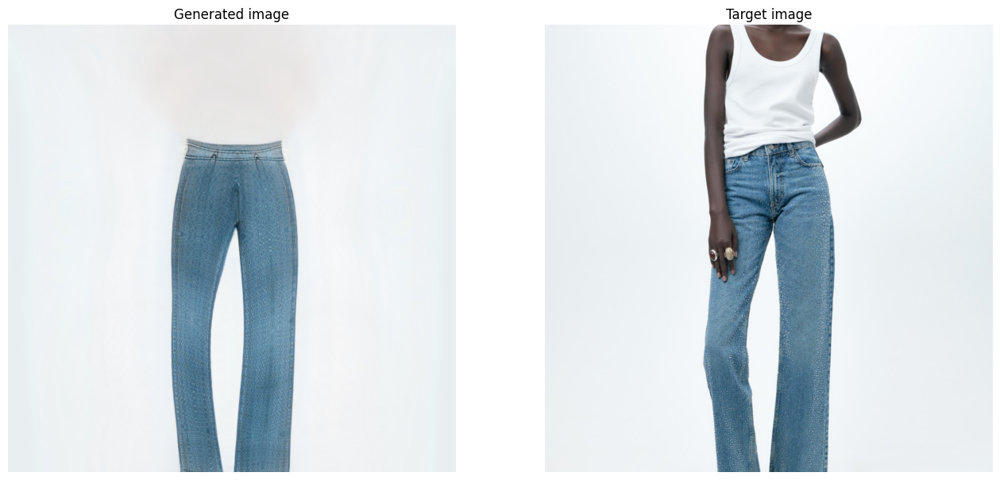

Step [700/1000], Loss: 0.8156


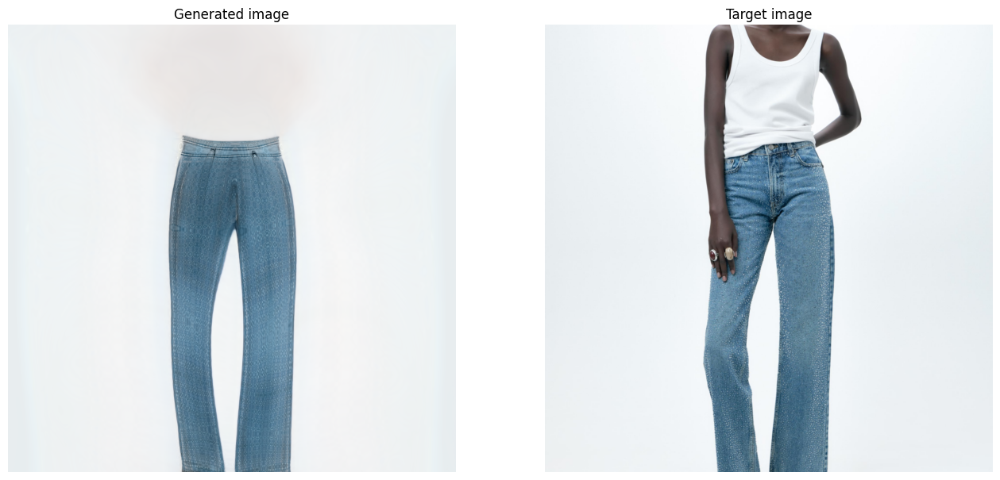

Step [750/1000], Loss: 0.7913


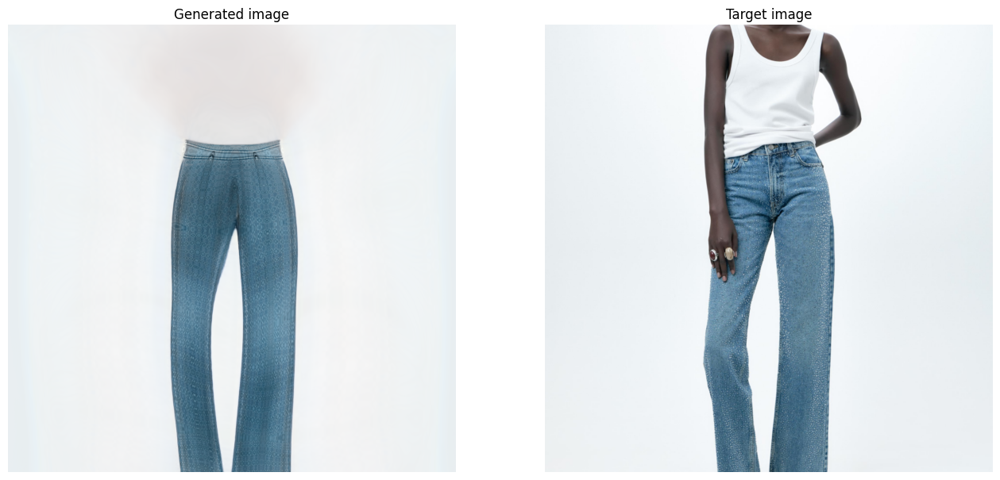

Step [800/1000], Loss: 0.7831


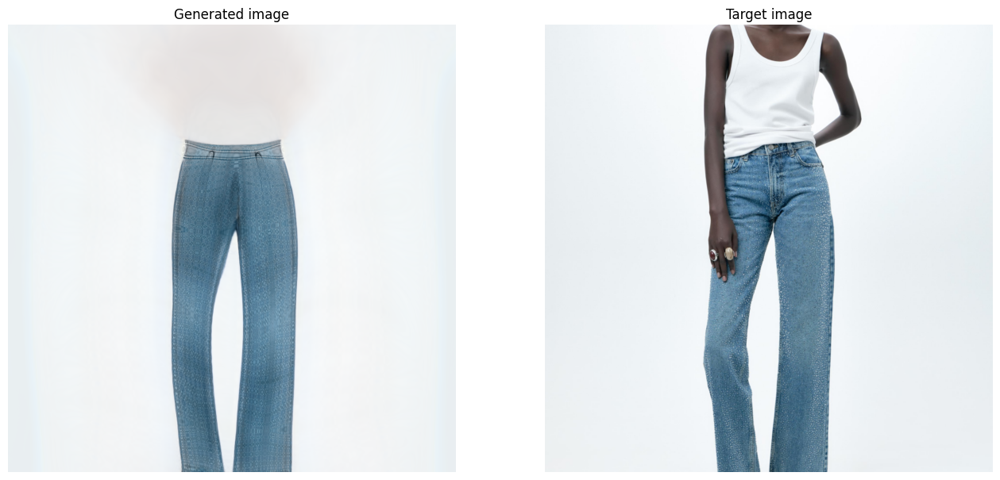

Step [850/1000], Loss: 0.7829


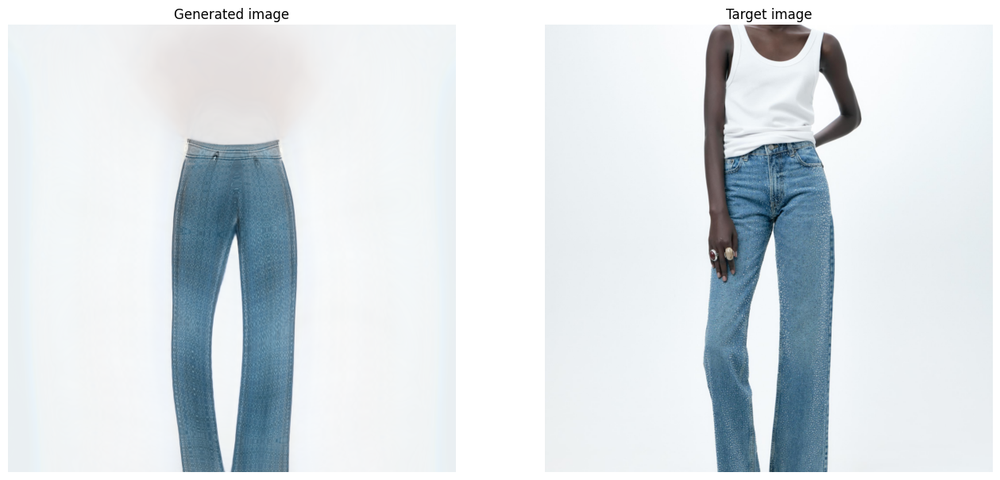

Step [900/1000], Loss: 0.7762


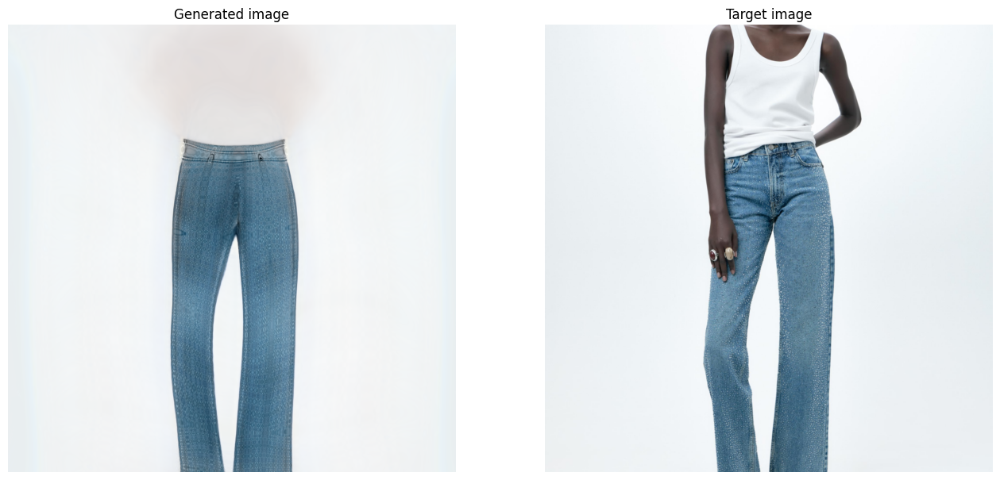

Step [950/1000], Loss: 0.7720


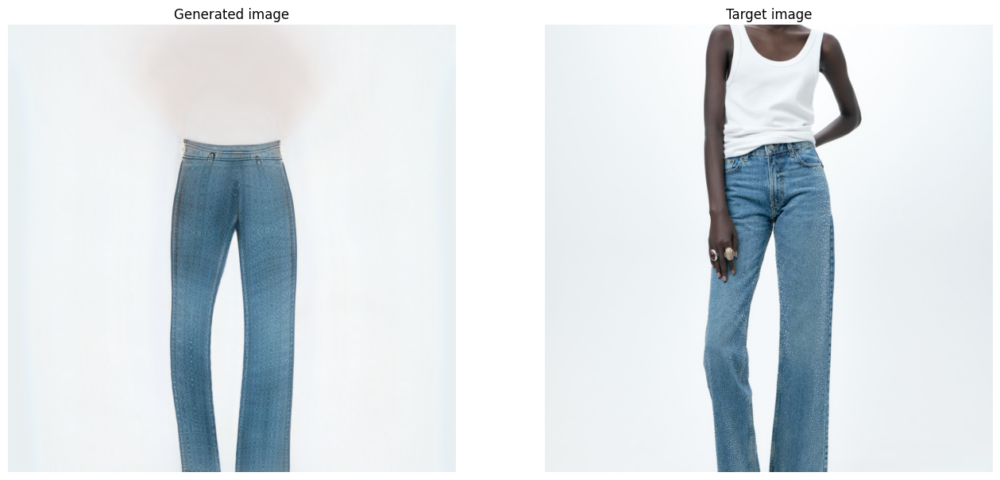

Inversion in W+ space completed!


In [50]:
# MSE
mse = torch.nn.MSELoss()

# We use W+ or W
w_plus = True  # True = use W+, False = W

num_steps_w = 1000  # 
alpha = 3  # Coefficient LPIPS

device = "cuda" if torch.cuda.is_available() else "cpu"

# We generate a random vector in Z-space
latent_z = torch.randn((1, G.z_dim), device=device)  

# Convert Z to W
latent_w = G.mapping(latent_z, None).detach().clone()  # We make a copy without gradients

# If we use W+, we extend the W-code for all layers
if w_plus:
    latent_w = latent_w.repeat(1, G.num_ws, 1) 

# We make sure that latent_w has the correct size [1, num_ws, w_dim]
latent_w = latent_w[:, :G.num_ws, :].detach().clone().requires_grad_(True)

optimizer_w = optim.Adam([latent_w], lr=0.05)

losses = {
    'mse': [],
    'lpips': [],
    'all': []
}

# We start optimization
for step in range(num_steps_w):
    torch.cuda.empty_cache()
    optimizer_w.zero_grad()

    generated_img = G.synthesis(latent_w, noise_mode='random')

 
    mse_loss = mse(generated_img, target_img_tensor)  # MSE Loss
    lpips_loss = lpips_loss_fn(generated_img, target_img_tensor).mean()  # LPIPS Loss
    loss = mse_loss + alpha * lpips_loss 

    loss.backward()
    optimizer_w.step()  

    losses['mse'].append(mse_loss.item())
    losses['lpips'].append(lpips_loss.item())
    losses['all'].append(loss.item())

    if step % 50 == 0:
        print(f"Step [{step}/{num_steps_w}], Loss: {loss.item():.4f}")

        fig, axs = plt.subplots(1, 2, figsize=(16, 32))

        axs[0].imshow((generated_img.cpu().detach()[0].permute(1, 2, 0) + 1) / 2)
        axs[0].set_title("Generated image")
        axs[0].axis('off')

        axs[1].imshow((target_img_tensor.cpu().detach()[0].permute(1, 2, 0) + 1) / 2)
        axs[1].set_title("Target image")
        axs[1].axis('off')

        plt.show()
        save_image(generated_img, f"inversion_step_{step}.png")

print("Inversion in W+ space completed!")

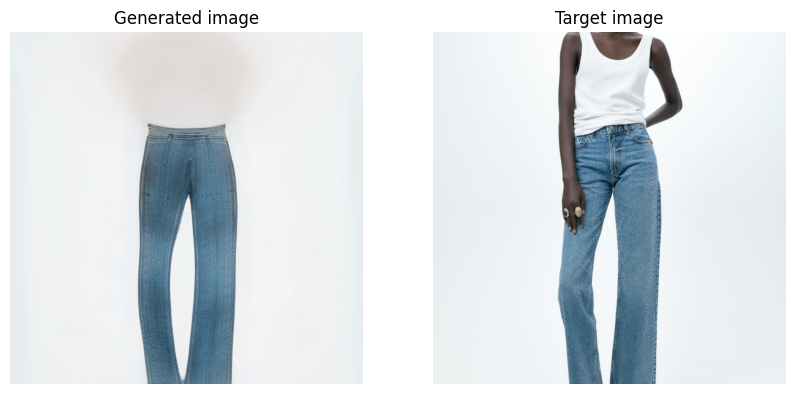

In [51]:
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow((generated_img.cpu().detach().squeeze().permute(1, 2, 0) + 1) / 2)
axs[0].set_title("Generated image")
axs[0].axis('off')

axs[1].imshow((target_img_tensor.cpu().squeeze().permute(1, 2, 0).clip(-1,1) + 1) / 2)
axs[1].set_title("Target image")
axs[1].axis('off')

plt.show()

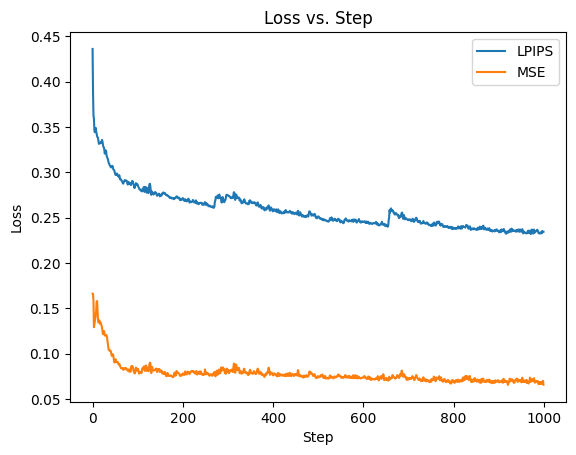

In [52]:
# We visualize the loss functions in the process of optimization
plt.plot(losses['lpips'], label='LPIPS')
plt.plot(losses['mse'], label='MSE')
#plt.plot(losses['noise_reg'], label='Noise')
plt.title("Loss vs. Step")
plt.xlabel("Step")
plt.ylabel("Loss")
plt.legend()
plt.show()

# ==============================================================
# Demonstrating the Maximum Accuracy of StyleGAN3
# ==============================================================
# In this step, we showcase the high precision that StyleGAN3 can achieve 
# when trained on a large dataset of high-quality images.
# 
# Specifically, we use a pre-trained model trained on FFHQ (Flickr-Faces-HQ), 
# which contains 70,000 high-resolution human face images. 
#
# ✅ The goal is to generate ultra-realistic faces and demonstrate 
#    the model's ability to produce high-detail, alias-free images.
#
# 🔹 Key characteristics of this model:
#    - Trained on a massive dataset with diverse variations.
#    - High-resolution outputs (1024×1024 pixels).
#    - No aliasing artifacts, thanks to filtered convolutions.
#    - Realistic facial features, shadows, and lighting.
#
# 📌 In the next step, we will generate multiple images and visualize them.


# The model is trained on a huge number of images

In [57]:
import legacy
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


network_pkl = "https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/stylegan3-r-ffhq-1024x1024.pkl"

with dnnlib.util.open_url(network_pkl) as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device)  

In [62]:
z = torch.randn([1, G.z_dim], device=device) 
img = G(z, None)  

img = (img.clamp(-1, 1) + 1) / 2  
img = (img * 255).byte()  
img = img.permute(0, 2, 3, 1).cpu().numpy()[0]  



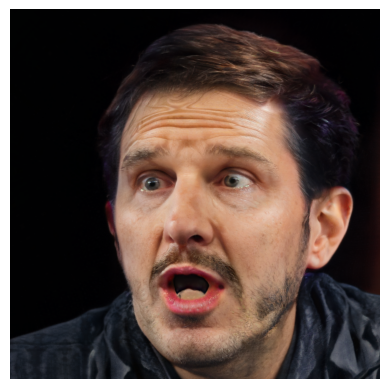

In [99]:
plt.imshow(img)
plt.axis("off")
plt.show()


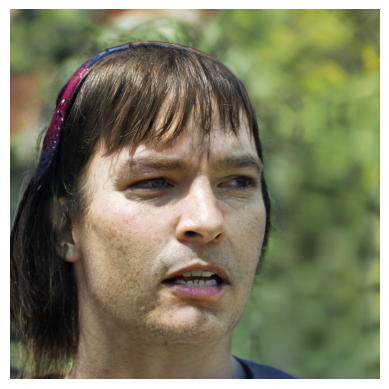

In [59]:
plt.imshow(img)
plt.axis("off")
plt.show()

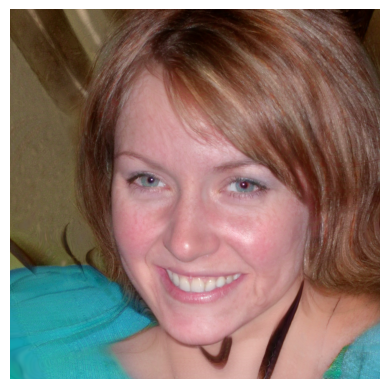

In [63]:
plt.imshow(img)
plt.axis("off")
plt.show()

The real image is loaded and prepared.


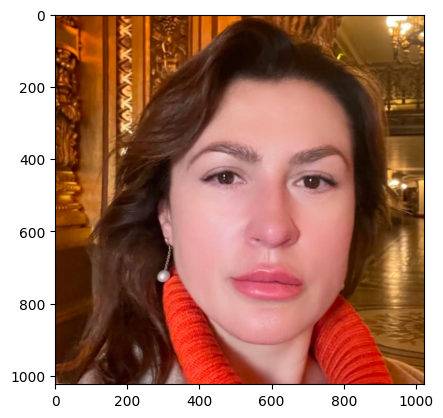

In [64]:
real_image_path = '/kaggle/input/8888888/image8.jpeg'

target_img = Image.open(real_image_path).convert('RGB')

transform = transforms.Compose([
    transforms.CenterCrop(min(target_img.size)),
    transforms.Resize((1024, 1024))
])


target_img = transform(target_img)

target_img_tensor = torch.tensor(np.array(target_img).transpose(2, 0, 1)).float().to(device) / 255.
target_img_tensor = target_img_tensor.unsqueeze(0)* 2 - 1 

print("The real image is loaded and prepared.")

plt.imshow((target_img_tensor.cpu()[0].permute(1, 2, 0) + 1)/2)

plt.show()

Step [0/1200], Loss: 2.9995


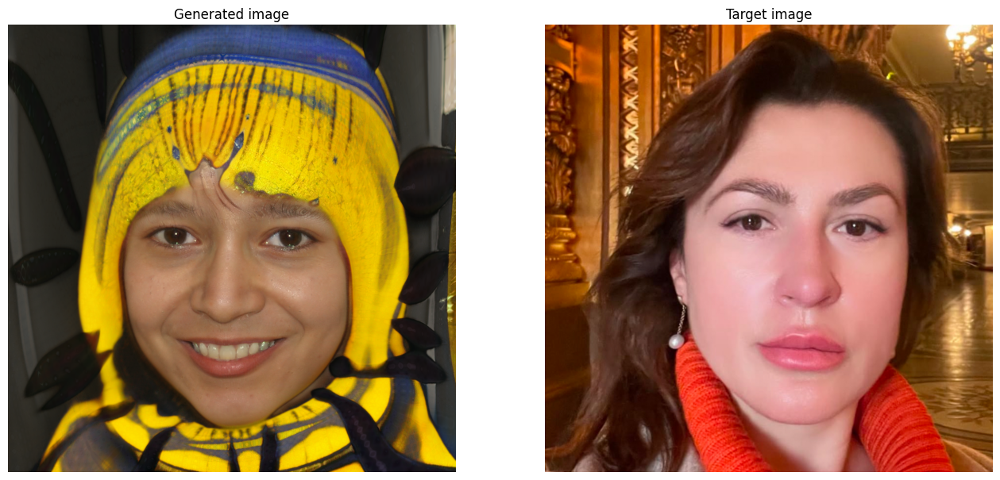

Step [50/1200], Loss: 1.6153


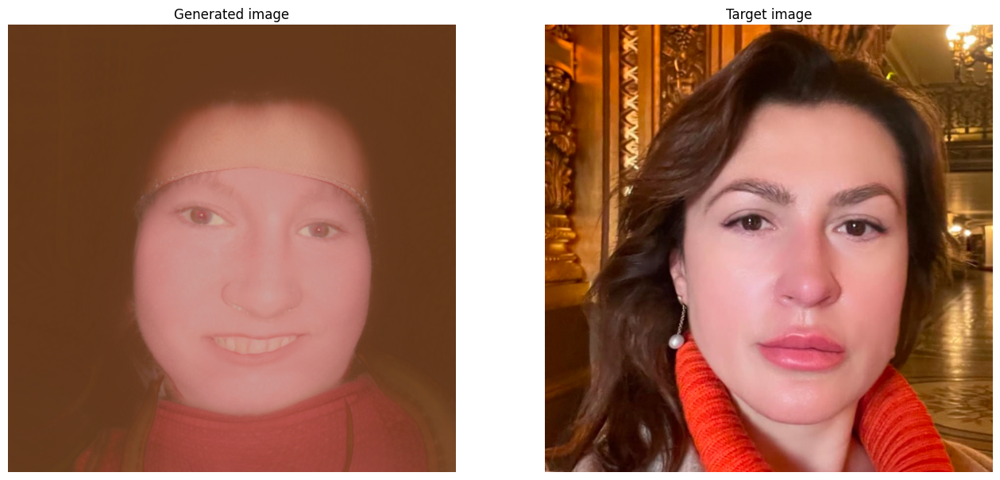

Step [100/1200], Loss: 1.5738


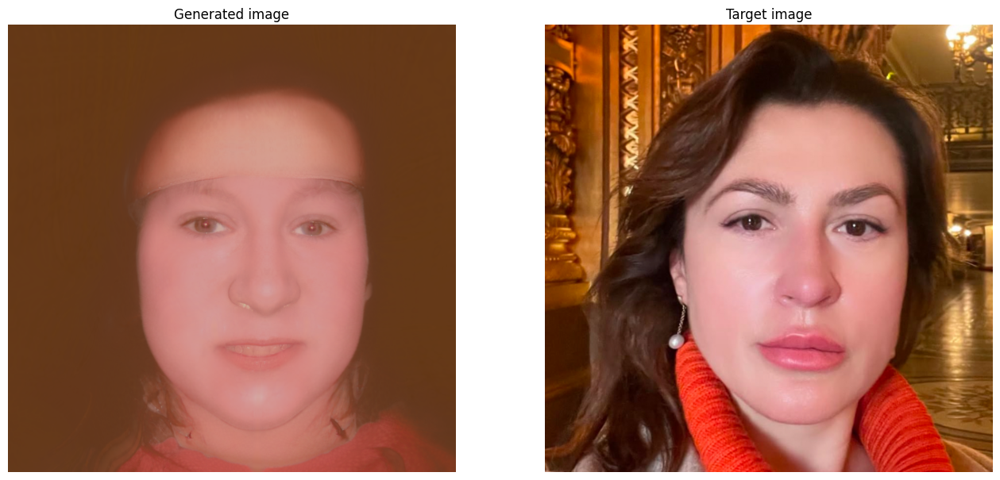

Step [150/1200], Loss: 1.5054


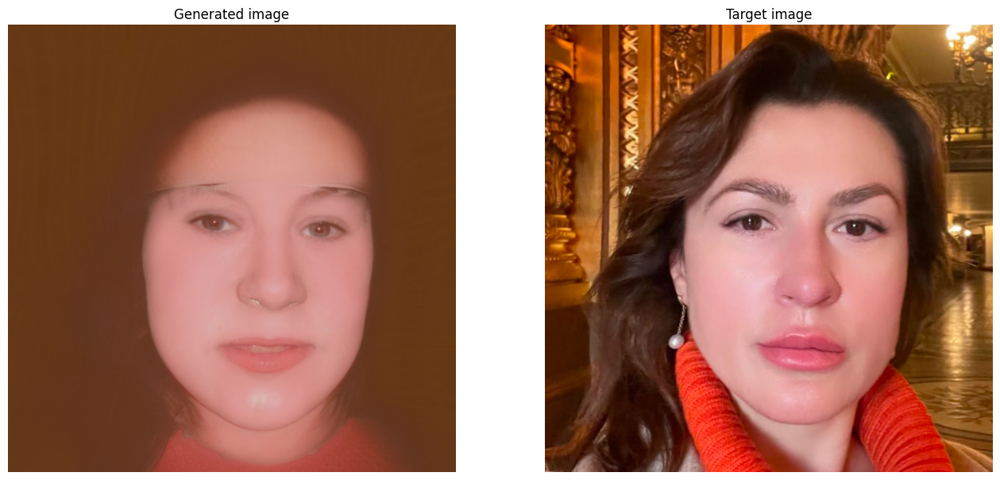

Step [200/1200], Loss: 1.4540


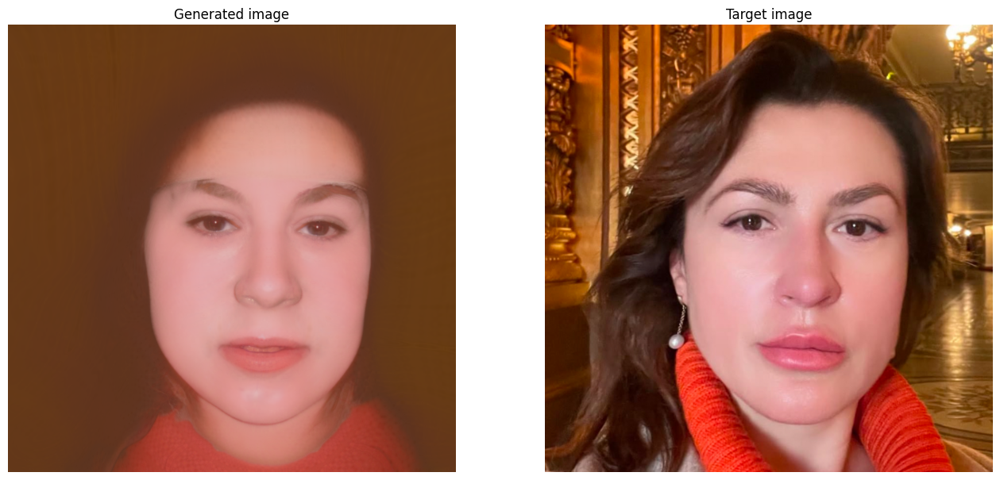

Step [250/1200], Loss: 1.4305


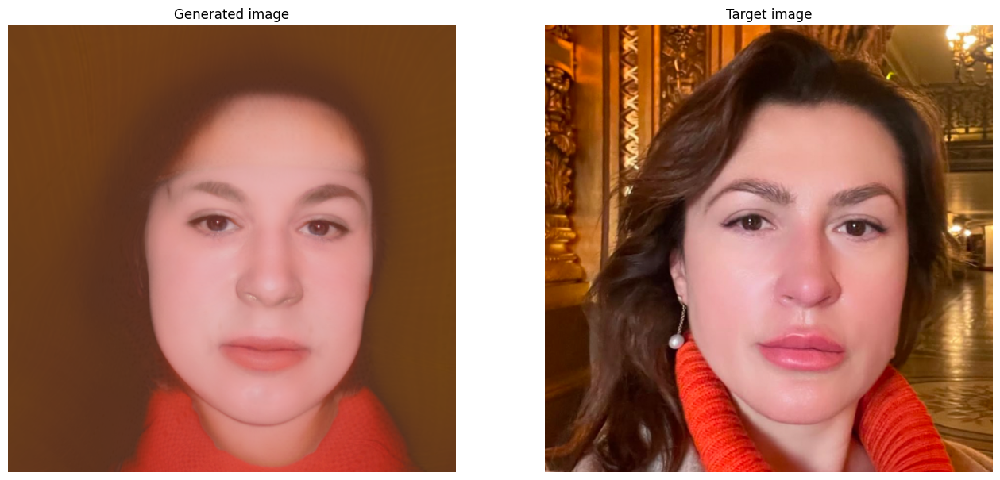

Step [300/1200], Loss: 1.3821


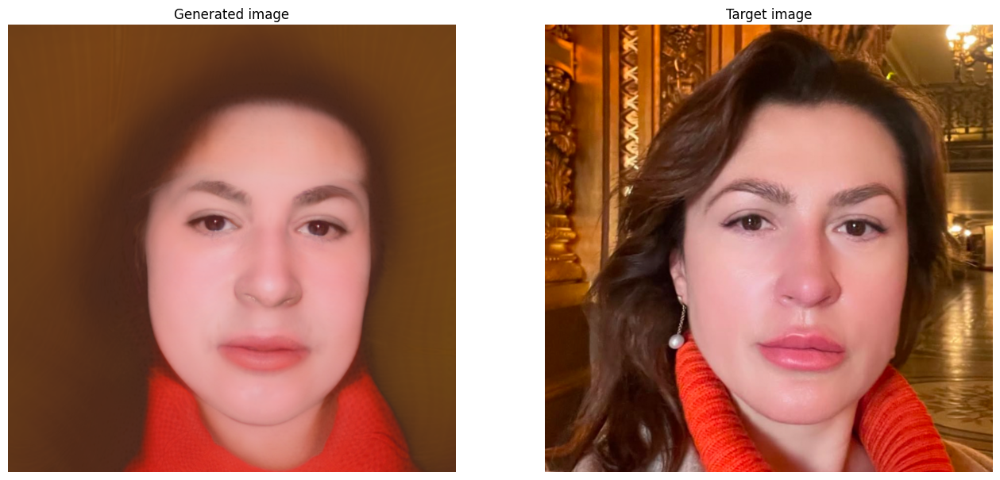

Step [350/1200], Loss: 1.3698


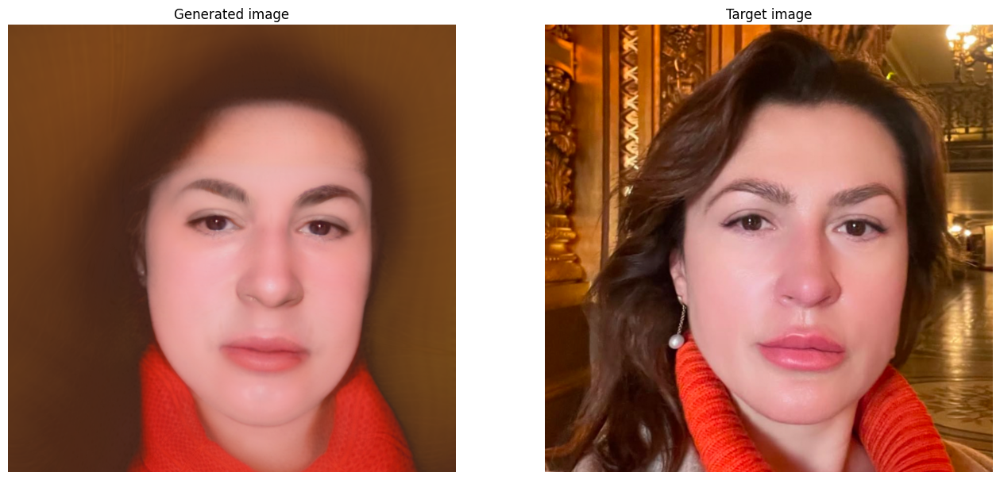

Step [400/1200], Loss: 1.3491


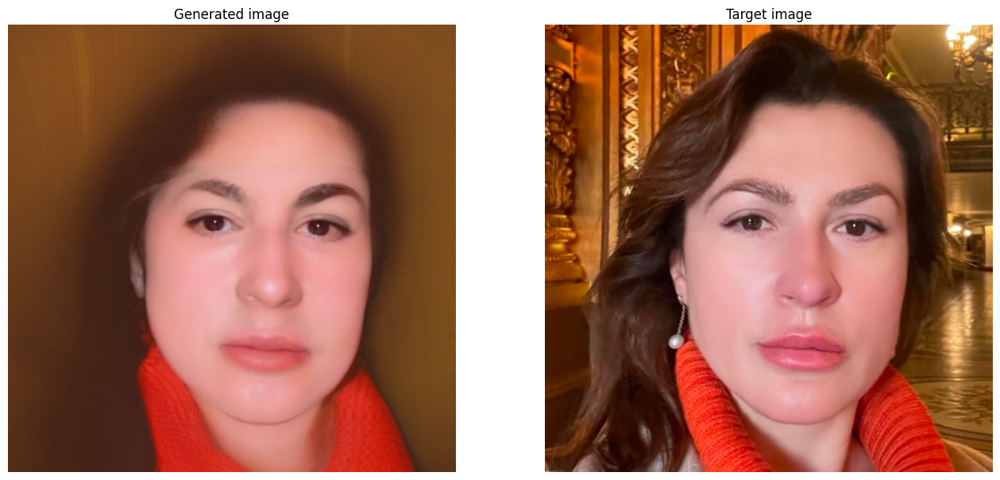

Step [450/1200], Loss: 1.3181


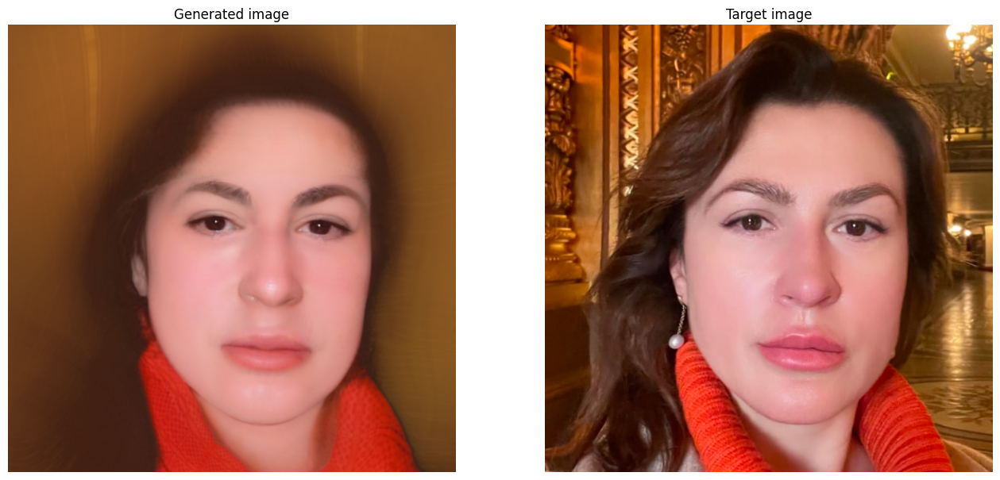

Step [500/1200], Loss: 1.3299


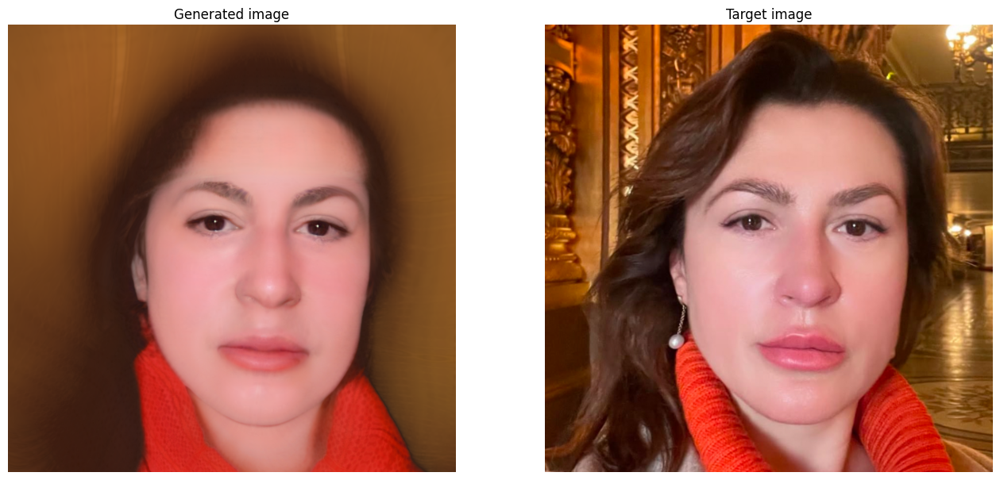

Step [550/1200], Loss: 1.3004


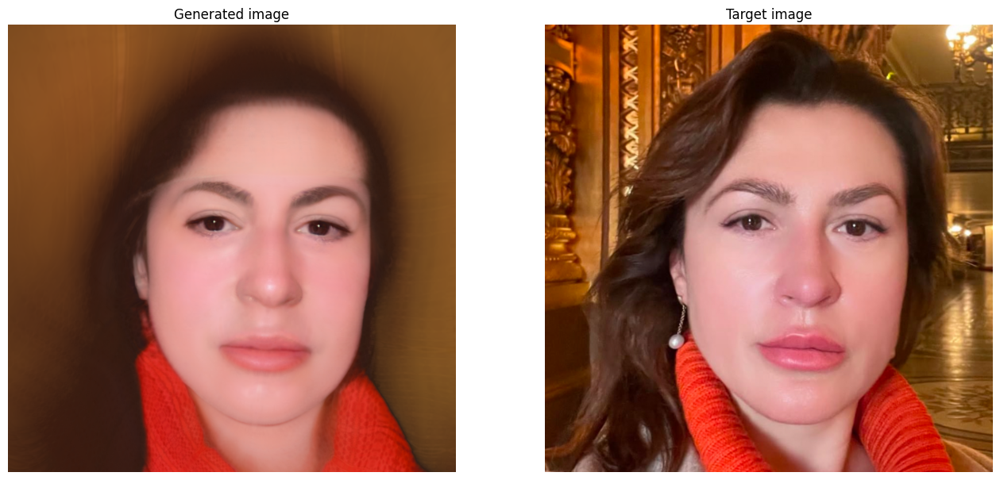

Step [600/1200], Loss: 1.3059


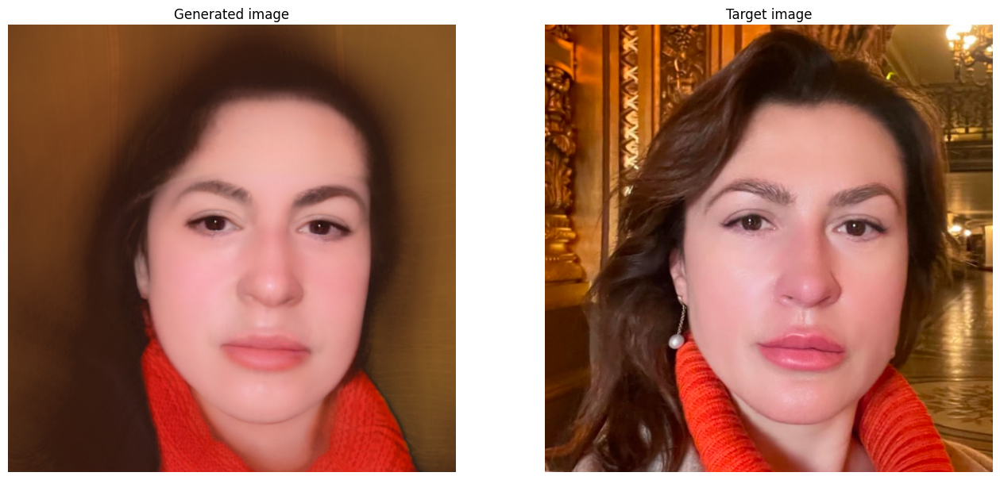

Step [650/1200], Loss: 1.2723


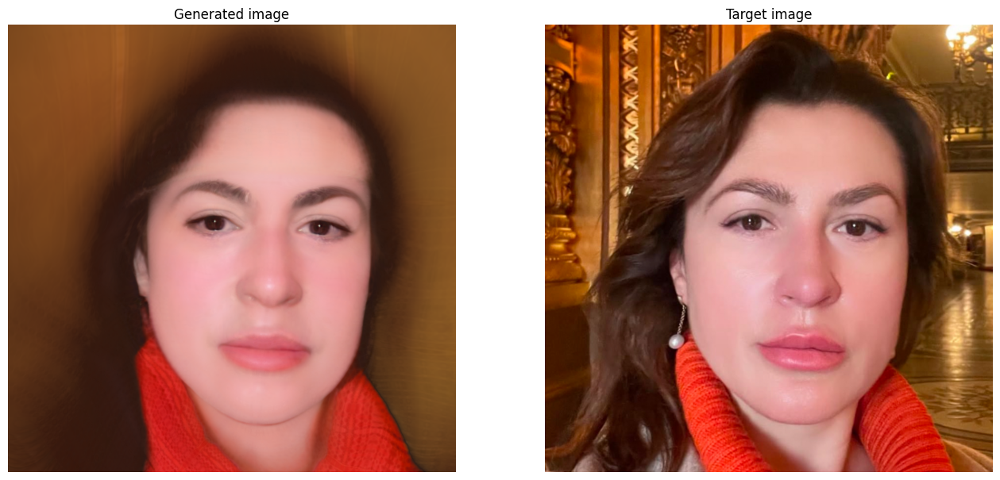

Step [700/1200], Loss: 1.2640


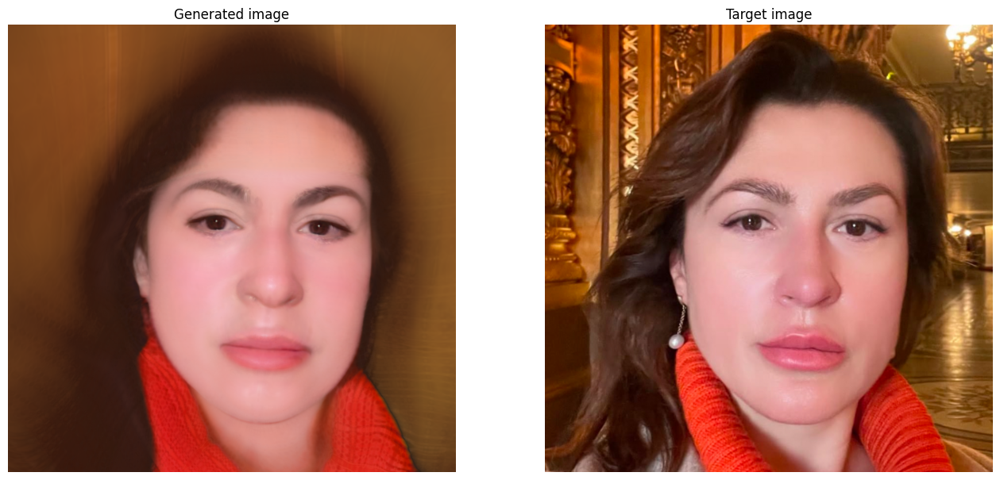

Step [750/1200], Loss: 1.2515


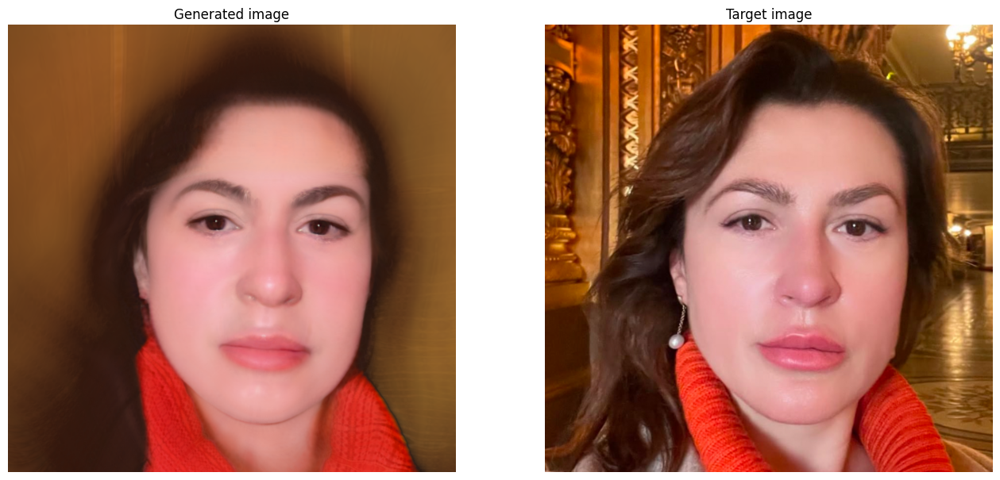

Step [800/1200], Loss: 1.2435


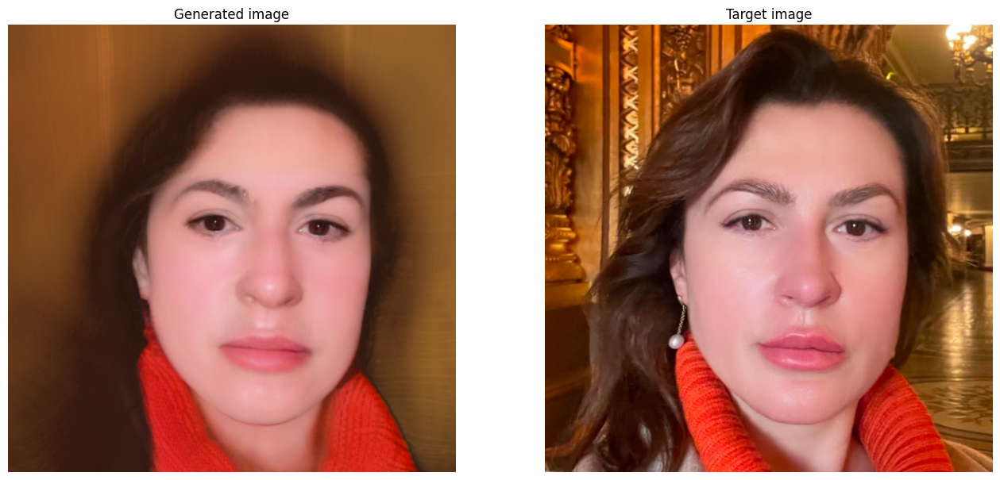

Step [850/1200], Loss: 1.2355


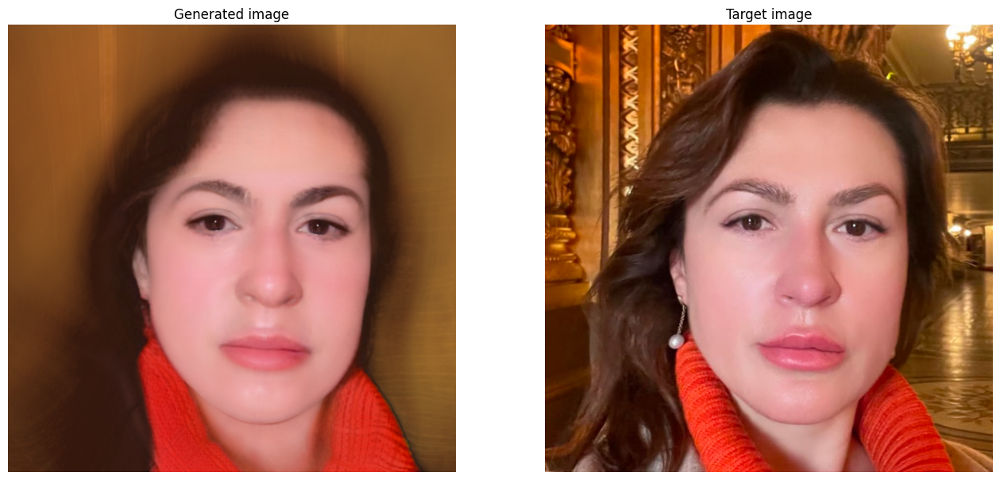

Step [900/1200], Loss: 1.2440


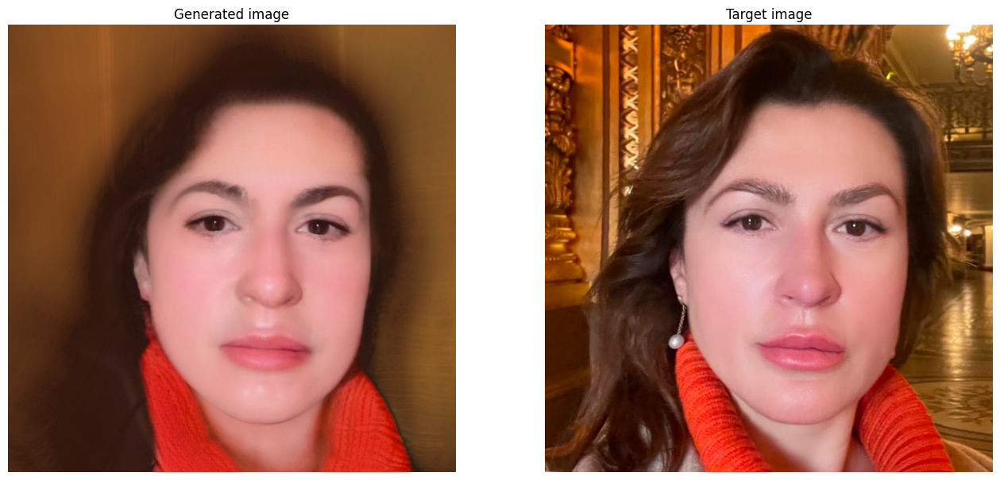

Step [950/1200], Loss: 1.2322


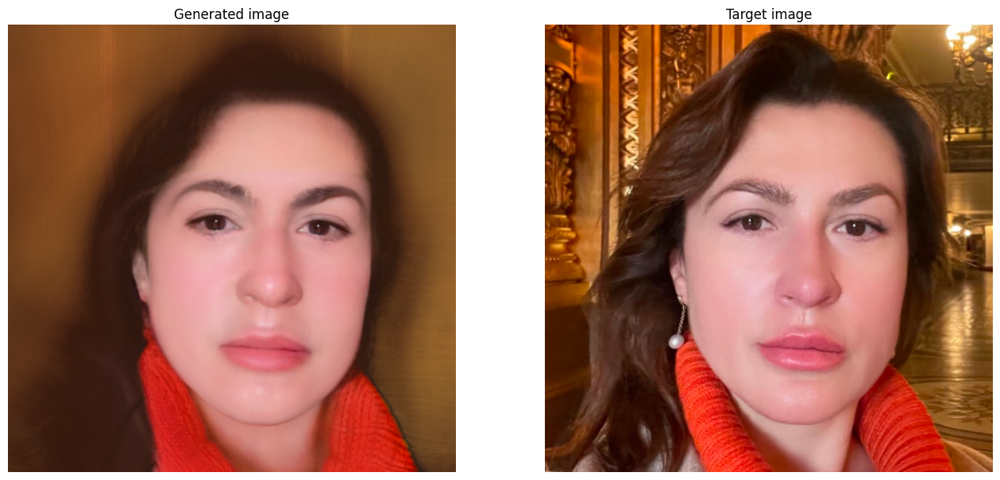

Step [1000/1200], Loss: 1.2151


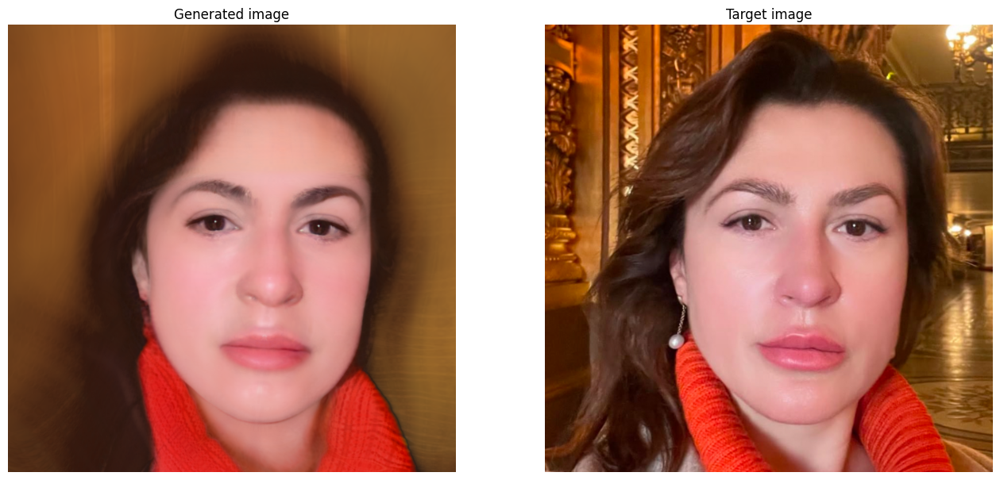

Step [1050/1200], Loss: 1.2148


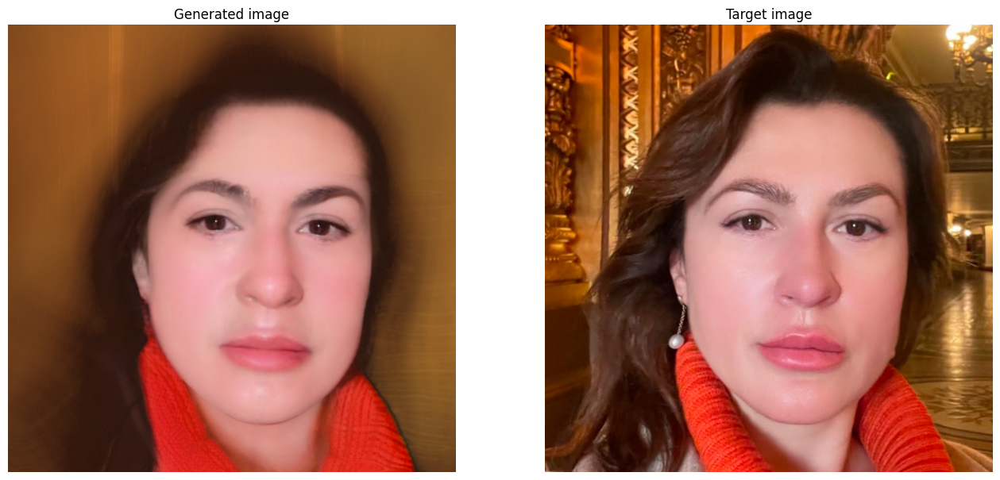

Step [1100/1200], Loss: 1.2131


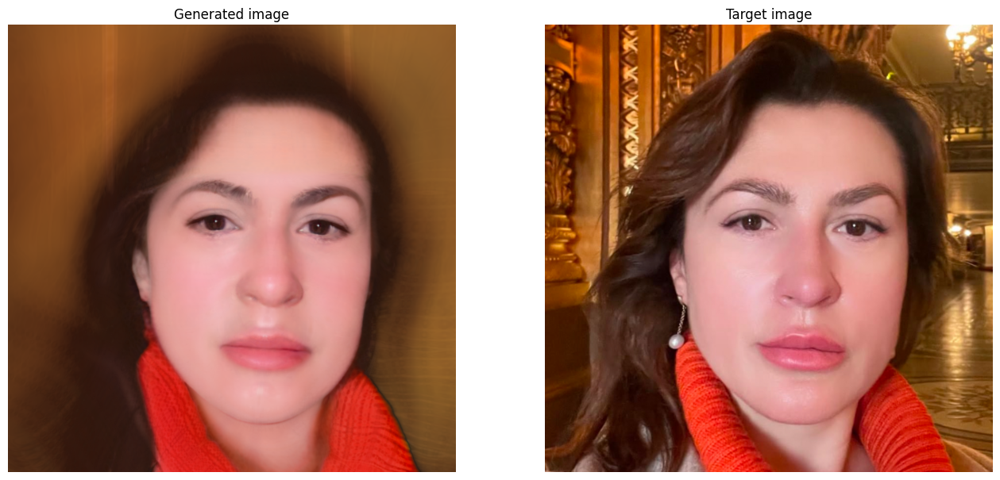

Step [1150/1200], Loss: 1.2110


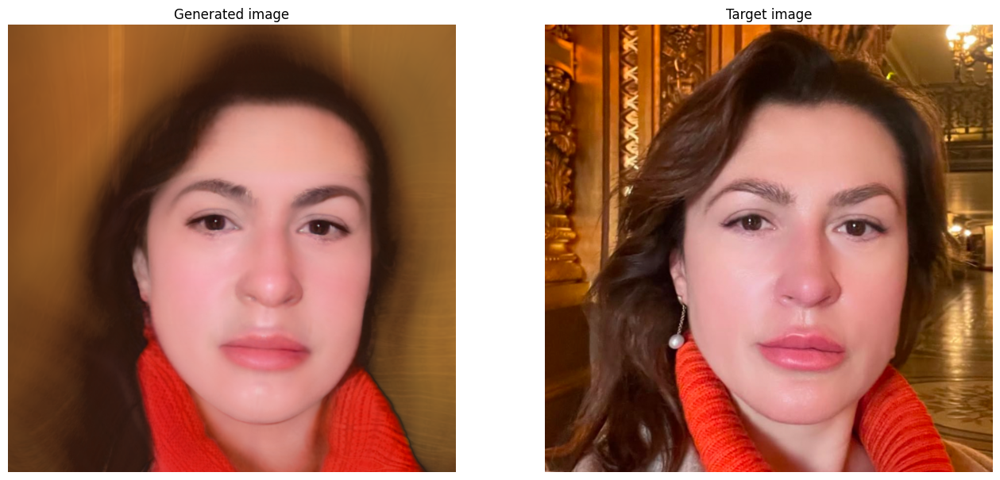

Inversion in W+ space completed!


In [65]:
# MSE
mse = torch.nn.MSELoss()

# We use W+ or W
w_plus = True  # True = use W+, False = W

num_steps_w = 1200  
alpha = 3  # Coefficient LPIPS

device = "cuda" if torch.cuda.is_available() else "cpu"

# We generate a random vector in Z-space
latent_z = torch.randn((1, G.z_dim), device=device)  

# Convert Z to W
latent_w = G.mapping(latent_z, None).detach().clone()  # We make a copy without gradients

# If we use W+, we extend the W-code for all layers
if w_plus:
    latent_w = latent_w.repeat(1, G.num_ws, 1) 

# We make sure that latent_w has the correct size [1, num_ws, w_dim]
latent_w = latent_w[:, :G.num_ws, :].detach().clone().requires_grad_(True)

optimizer_w = optim.Adam([latent_w], lr=0.05)

losses = {
    'mse': [],
    'lpips': [],
    'all': []
}

# We start optimization
for step in range(num_steps_w):
    torch.cuda.empty_cache()
    optimizer_w.zero_grad()

    generated_img = G.synthesis(latent_w, noise_mode='random')

 
    mse_loss = mse(generated_img, target_img_tensor)  # MSE Loss
    lpips_loss = lpips_loss_fn(generated_img, target_img_tensor).mean()  # LPIPS Loss
    loss = mse_loss + alpha * lpips_loss 

    loss.backward()
    optimizer_w.step()  

    losses['mse'].append(mse_loss.item())
    losses['lpips'].append(lpips_loss.item())
    losses['all'].append(loss.item())

    if step % 50 == 0:
        print(f"Step [{step}/{num_steps_w}], Loss: {loss.item():.4f}")

        fig, axs = plt.subplots(1, 2, figsize=(16, 32))

        axs[0].imshow((generated_img.cpu().detach()[0].permute(1, 2, 0) + 1) / 2)
        axs[0].set_title("Generated image")
        axs[0].axis('off')

        axs[1].imshow((target_img_tensor.cpu().detach()[0].permute(1, 2, 0) + 1) / 2)
        axs[1].set_title("Target image")
        axs[1].axis('off')

        plt.show()
        save_image(generated_img, f"inversion_step_{step}.png")

print("Inversion in W+ space completed!")